In [1]:
import os
import numpy as np 
import pandas as pd
from PIL import Image, ImageOps
import matplotlib.pyplot as plt
from bs4 import BeautifulSoup

In [2]:
import tensorflow as tf


In [3]:
print(tf.config.list_physical_devices('GPU'))

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [4]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999;

<IPython.core.display.Javascript object>

In [5]:
pd.set_option("display.max_columns", 100)
pd.set_option("display.max_rows", 200)
pd.set_option("display.max_colwidth",200)

#### Stanford Dogs Dataset

The Stanford Dogs dataset contains images of 120 breeds of dogs from around the world. This dataset has been built using images and annotation from ImageNet for the task of fine-grained image categorization. Contents of this dataset:



-    Number of categories: 120
-    Number of images: 20,580
-    Annotations: Class labels, Bounding boxes


In [6]:
path = '/home/thomas/Documents/openclassroom/projet6/'
pathImages = path + 'Images/'
pathAnn = path + 'Annotation/'
#pathKerasTrain = path + 'all_breeds/train/'
#pathKerasTest = path + 'all_breeds/test/'
#pathKerasVal = path + 'all_breeds/validation/'
pathKerasTrain10 = path + '10_breeds/train/'
pathKerasTest10 = path + '10_breeds/test/'
pathKerasVal10 = path + '10_breeds/validation/'

# Create Dataframe

### Test

In [7]:
pathTest = '/home/thomas/Documents/openclassroom/projet6/Annotation/n02085620-Chihuahua/n02085620_7'

In [8]:
with open(pathTest, 'r') as f:
    data = f.read()
    
data = BeautifulSoup(data, "xml")
print(data)

<?xml version="1.0" encoding="utf-8"?>
<annotation>
<folder>02085620</folder>
<filename>n02085620_7</filename>
<source>
<database>ImageNet database</database>
</source>
<size>
<width>250</width>
<height>188</height>
<depth>3</depth>
</size>
<segment>0</segment>
<object>
<name>Chihuahua</name>
<pose>Unspecified</pose>
<truncated>0</truncated>
<difficult>0</difficult>
<bndbox>
<xmin>71</xmin>
<ymin>1</ymin>
<xmax>192</xmax>
<ymax>180</ymax>
</bndbox>
</object>
</annotation>


In [9]:
data.find('filename').text

'n02085620_7'

### loader

In [10]:
dic = {'filename':[],'name':[],'width':[],'height':[],'depth':[],'truncated':[]}

In [11]:
def loaderAnn (path,keys):
    ''' scrawl in the path to find annotation files which are supposed to be Xml files.
        Then open files and add the element's value to the corresponding key in a dictionary '''
        
    global dic
    for file in os.listdir(path):
        fpath = path + file
        if os.path.isdir(fpath):
            fpath += '/'
            loaderAnn(fpath,keys)
        elif os.path.isfile(fpath):
            with open(fpath, 'r') as f:
                data = f.read()
                data = BeautifulSoup(data, "xml")
                for key in keys:
                    dic[key].append(data.find(key).text)
                

In [12]:
loaderAnn(pathAnn,['filename','name','width','height','depth','truncated'])

In [13]:
for i in ['filename','name','width','height','depth','truncated']:
 print(f" {i:16} {len(dic[i])}")

 filename         20580
 name             20580
 width            20580
 height           20580
 depth            20580
 truncated        20580


In [14]:
df = pd.DataFrame(data=dic)
df.rename(columns={"name": "label"},inplace=True)
df['path'] = ['path' for i in range(len(dic['filename']))]

In [15]:
df.head(5)

,filename,label,width,height,depth,truncated,path
0,n02112018_2483,Pomeranian,500,375,3,0,path
1,n02112018_3090,Pomeranian,349,360,3,0,path
2,n02112018_2931,Pomeranian,500,375,3,0,path
3,n02112018_7019,Pomeranian,500,333,3,0,path
4,n02112018_1561,Pomeranian,500,451,3,0,path


In [16]:
def loaderImage (path,key):
    ''' scrawl in the path to find files which are supposed to be jpeg files.
        Then open files and add the element's path to the dataframe '''
        
    global dic
    for file in os.listdir(path):
        fpath = path + file
        if os.path.isdir(fpath):
            fpath += '/'
            loaderImage(fpath,key)
        elif os.path.isfile(fpath):
            if fpath.endswith('jpg'):
                name = fpath.split('/')[-1] # strip path
                name = name.split('.')[0]
                index=df[df['filename']==name].index
                df.loc[index,key] = fpath
                

In [17]:
loaderImage(pathImages,'path')

In [18]:
df.head(5)

,filename,label,width,height,depth,truncated,path
0,n02112018_2483,Pomeranian,500,375,3,0,/home/thomas/Documents/openclassroom/projet6/Images/n02112018-Pomeranian/n02112018_2483.jpg
1,n02112018_3090,Pomeranian,349,360,3,0,/home/thomas/Documents/openclassroom/projet6/Images/n02112018-Pomeranian/n02112018_3090.jpg
2,n02112018_2931,Pomeranian,500,375,3,0,/home/thomas/Documents/openclassroom/projet6/Images/n02112018-Pomeranian/n02112018_2931.jpg
3,n02112018_7019,Pomeranian,500,333,3,0,/home/thomas/Documents/openclassroom/projet6/Images/n02112018-Pomeranian/n02112018_7019.jpg
4,n02112018_1561,Pomeranian,500,451,3,0,/home/thomas/Documents/openclassroom/projet6/Images/n02112018-Pomeranian/n02112018_1561.jpg


In [19]:
df['width'] =df['width'].apply(lambda x: int(x))
df['height'] =df['height'].apply(lambda x: int(x))
df['depth'] =df['depth'].apply(lambda x: int(x))

In [20]:
df.isna().any()

filename     False
label        False
width        False
height       False
depth        False
truncated    False
path         False
dtype: bool

In [21]:
df[df['path']=='path']

,filename,label,width,height,depth,truncated,path
1247,%s,Shetland_sheepdog,500,375,3,0,path
1248,%s,Shetland_sheepdog,500,415,3,0,path
1249,%s,Shetland_sheepdog,314,224,3,0,path
1250,%s,Shetland_sheepdog,500,375,3,0,path
1251,%s,Shetland_sheepdog,500,369,3,0,path
...,...,...,...,...,...,...,...
17088,%s,French_bulldog,500,375,3,0,path
17089,%s,French_bulldog,500,374,3,0,path
17090,%s,French_bulldog,387,473,3,0,path
17091,%s,French_bulldog,333,500,3,0,path


In [22]:
df[df['filename']=='%s']

,filename,label,width,height,depth,truncated,path
1247,%s,Shetland_sheepdog,500,375,3,0,path
1248,%s,Shetland_sheepdog,500,415,3,0,path
1249,%s,Shetland_sheepdog,314,224,3,0,path
1250,%s,Shetland_sheepdog,500,375,3,0,path
1251,%s,Shetland_sheepdog,500,369,3,0,path
...,...,...,...,...,...,...,...
17088,%s,French_bulldog,500,375,3,0,path
17089,%s,French_bulldog,500,374,3,0,path
17090,%s,French_bulldog,387,473,3,0,path
17091,%s,French_bulldog,333,500,3,0,path


In [23]:
df[df['filename']=='%s'].value_counts('label')

label
French_bulldog       159
English_foxhound     157
Shetland_sheepdog    157
otterhound           151
dtype: int64

624 files don't have a filename and a path

In [24]:
del df
dic = {'filename':[],'name':[],'width':[],'height':[],'depth':[],'truncated':[]}

In [25]:
def loaderAnn (path,keys):
    ''' scrawl in the path to find annotation files which are supposed to be Xml files.
        Then open files and add the element's value to the corresponding key in a dictionary '''
        
    global dic
    for file in os.listdir(path):
        fpath = path + file
        if os.path.isdir(fpath):
            fpath += '/'
            loaderAnn(fpath,keys)
        elif os.path.isfile(fpath):
            with open(fpath, 'r') as f:
                data = f.read()
                data = BeautifulSoup(data, "xml")
                for key in keys:
                    if key != 'filename':
                        dic[key].append(data.find(key).text)
                    else:
                        if data.find(key).text == '%s':
                            filename = fpath.split('/')[-1]
                            dic[key].append(filename)
                        else:
                            dic[key].append(data.find(key).text)

In [26]:
loaderAnn(pathAnn,['filename','name','width','height','depth','truncated'])

In [27]:
df = pd.DataFrame(data=dic)
df.rename(columns={"name": "label"},inplace=True)
df['path'] = ['path' for i in range(len(dic['filename']))]

In [28]:
def loaderImage (path,key):
    ''' scrawl in the path to find files which are supposed to be jpeg files.
        Then open files and add the element's path to the dataframe '''
        
    global dic
    for file in os.listdir(path):
        fpath = path + file
        if os.path.isdir(fpath):
            fpath += '/'
            loaderImage(fpath,key)
        elif os.path.isfile(fpath):
            if fpath.endswith('jpg'):
                name = fpath.split('/')[-1] # strip path
                name = name.split('.')[0]
                index=df[df['filename']==name].index
                df.loc[index,key] = fpath
                

In [29]:
loaderImage(pathImages,'path')

In [30]:
df['width'] =df['width'].apply(lambda x: int(x))
df['height'] =df['height'].apply(lambda x: int(x))
df['depth'] =df['depth'].apply(lambda x: int(x))

In [31]:
display(df.isna().any())
display(df[df['path']=='path'])
display(df[df['filename']=='%s'])

filename     False
label        False
width        False
height       False
depth        False
truncated    False
path         False
dtype: bool

,filename,label,width,height,depth,truncated,path


,filename,label,width,height,depth,truncated,path


## Exploration

In [32]:
plt.rcParams["figure.figsize"] = [18, 25]

<AxesSubplot: ylabel='label'>

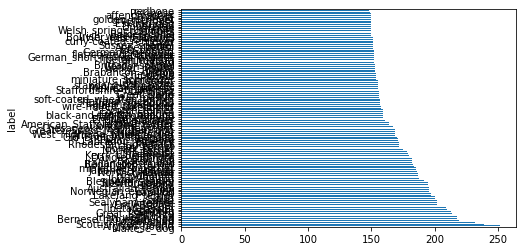

In [33]:
plt.rcParams["figure.figsize"] = [18, 25]
plotLabel = df.value_counts('label')
plotLabel.plot(kind='barh')

In [34]:
plotLabel

label
Maltese_dog                       252
Afghan_hound                      239
Scottish_deerhound                232
Pomeranian                        219
Samoyed                           218
Bernese_mountain_dog              218
Irish_wolfhound                   218
Shih-Tzu                          214
Great_Pyrenees                    213
Leonberg                          210
basenji                           209
Tibetan_terrier                   206
EntleBucher                       202
Airedale                          202
Sealyham_terrier                  202
Saluki                            200
pug                               200
cairn                             197
Lakeland_terrier                  197
papillon                          196
Norwegian_elkhound                196
chow                              196
Australian_terrier                196
beagle                            195
Newfoundland                      195
Siberian_husky                    192
Blenhe

Maltese_dog           252 \
redbone               148

In [35]:
plt.rcParams["figure.figsize"] = [18, 25]
countPixel = df.value_counts(df['height']*df['width'])
countPixel

187500    6526
166500    2804
167000     494
166000     393
200000     192
          ... 
49476        1
115210       1
115239       1
115248       1
10500        1
Length: 3707, dtype: int64

3707 different images size

In [36]:
df['height'].describe(percentiles=[.05,.10,.15,.25,.75])

count    20580.000000
mean       385.861224
std        124.863446
min        100.000000
5%         210.000000
10%        259.000000
15%        300.000000
25%        333.000000
50%        375.000000
75%        453.000000
max       2562.000000
Name: height, dtype: float64

In [37]:
df['width'].describe(percentiles=[.05,.10,.15,.25,.75])

count    20580.000000
mean       442.531876
std        142.792308
min         97.000000
5%         221.000000
10%        288.000000
15%        325.000000
25%        361.000000
50%        500.000000
75%        500.000000
max       3264.000000
Name: width, dtype: float64

In [38]:
df.value_counts(df['depth'])

depth
3    20580
dtype: int64

All images are in RGB

In [39]:
df['path'].head(3)

0    /home/thomas/Documents/openclassroom/projet6/Images/n02112018-Pomeranian/n02112018_2483.jpg
1    /home/thomas/Documents/openclassroom/projet6/Images/n02112018-Pomeranian/n02112018_3090.jpg
2    /home/thomas/Documents/openclassroom/projet6/Images/n02112018-Pomeranian/n02112018_2931.jpg
Name: path, dtype: object

check if all image have the same pixels mode.

In [40]:
df['mode'] = ['1' for i in df['filename']]

In [41]:
def isMode(df):
    for i in df['path']:
        img = Image.open(i)
        mode = img.mode
        index = df[df['path']==i].index
        df.loc[index,'mode'] = mode
    return df

In [42]:
df = isMode(df) 

In [43]:
df.value_counts('mode')

mode
RGB     20579
RGBA        1
dtype: int64

In [44]:
df[df['mode']=='RGBA']

,filename,label,width,height,depth,truncated,path,mode
1403,n02105855_2933,Shetland_sheepdog,213,189,3,0,/home/thomas/Documents/openclassroom/projet6/Images/n02105855-Shetland_sheepdog/n02105855_2933.jpg,RGBA


In [45]:
img = Image.open('/home/thomas/Documents/openclassroom/projet6/Images/n02105855-Shetland_sheepdog/n02105855_2933.jpg')

In [46]:
# Afficher son mode de quantification
print("Format des pixels : {}".format(img.mode))
mat  = np.array(img)
print(f"Taille de la matrice de pixels : {mat.shape}")

Format des pixels : RGBA
Taille de la matrice de pixels : (189, 213, 4)


 all image are in RGB mode exept one in RGBA

# Preprocessing steps
---

In [47]:
img = Image.open('/home/thomas/Documents/openclassroom/projet6/Images/n02112018-Pomeranian/n02112018_2483.jpg')
mat = np.array(img)
print(f"Taille de la matrice de pixels : {mat.shape}")

Taille de la matrice de pixels : (375, 500, 3)


In [48]:
def check_histo(func):
    def inner(*args,**kwargs):
        res = func(*args)
        mat = np.array(res)
        n, bins, patches = plt.hist(mat.flatten(), bins=range(256))
        plt.title(func.__name__)
        plt.show()
        return res
    return inner

In [49]:
def check_histo(func):
    def inner(*args,**kwargs):
        res = func(*args)
        mat = np.array(res)
        plt.figure(figsize=(40,14))
        plt.subplot(121)
        plt.hist(mat.flatten(), bins=range(256))
        plt.title(func.__name__)
        plt.subplot(122)
        plt.imshow(res,cmap='gray', vmin=0, vmax=255)
        plt.title(func.__name__)
        plt.show()
        return res
    return inner

In [50]:
@check_histo
def showImage(img):
    return img

@check_histo
def RGBtoBW(img):
    imgMono = img.convert(mode='L', matrix=None, dither=None, palette=None, colors=256)
    return imgMono

@check_histo
def autocontrast(img):
    rimg = ImageOps.autocontrast(img)
    return rimg

@check_histo
def equalize(img):
    rimg = ImageOps.equalize(img)
    return rimg

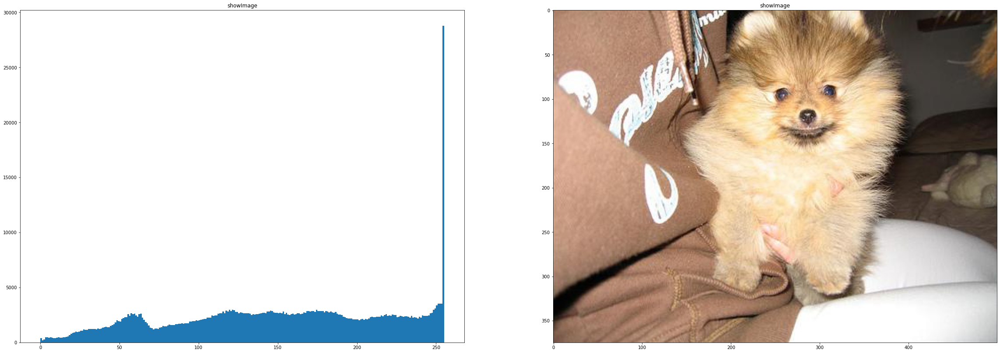

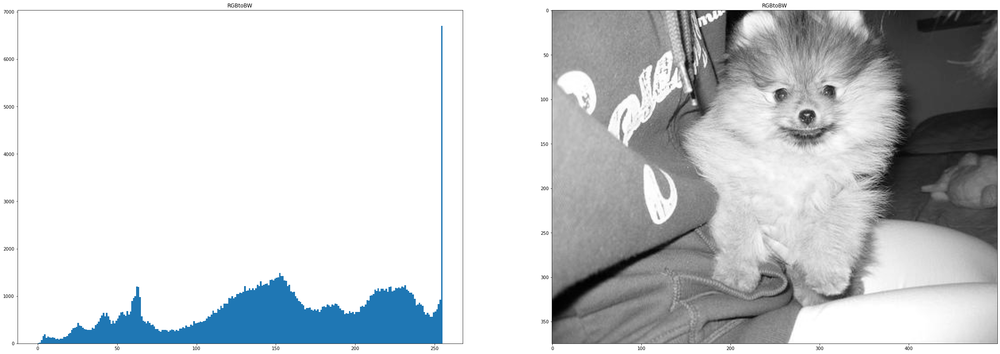

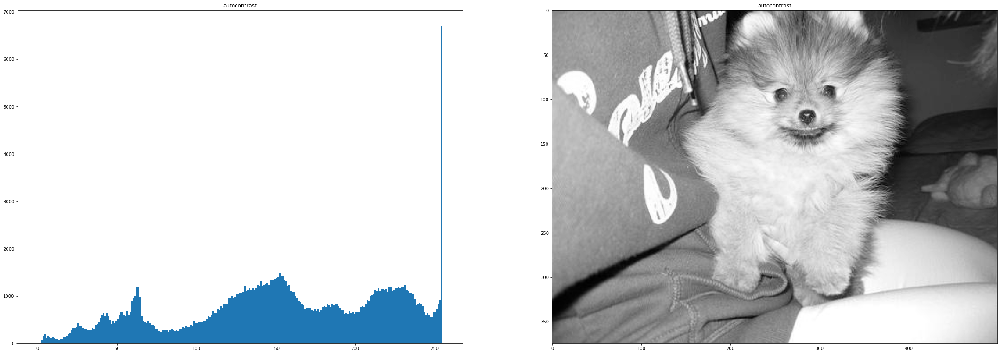

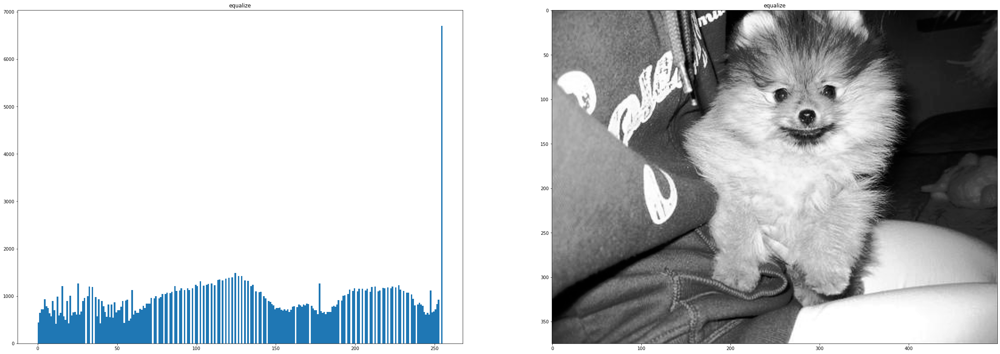

In [51]:
#RGBtoBW(mat).shape
img = Image.open('/home/thomas/Documents/openclassroom/projet6/Images/n02112018-Pomeranian/n02112018_2483.jpg')
showImage(img)
res=RGBtoBW(img)
res=autocontrast(res)
res = equalize(res)
#res.show()

## Resize

In [52]:
minW = np.min(df['width'])

In [53]:
minH = np.min(df['height'])

In [54]:
@check_histo
def resize(img,width,height):
    resizedImg = img.resize((width,height))
    return resizedImg
                            

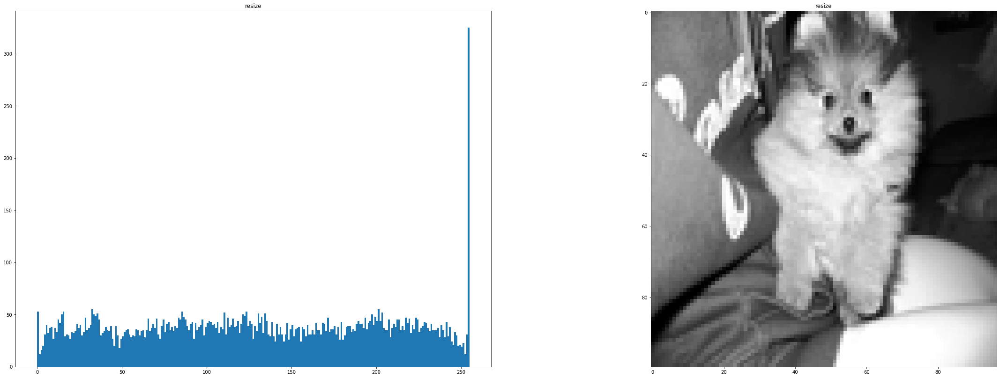

In [55]:
res = resize(res, minW,minH)

## Rotation

In [56]:
@check_histo
def rotate(img,angle):
    rotatedImg = img.rotate(angle, expand=True, center=(img.width // 2, img.height // 2), fillcolor=(0))# black color doesn't infer in backtracking
    return rotatedImg

def rotate_n(img,nb):
    rng = np.random.default_rng(12345)
    rints = rng.integers(low=-72, high=73, size=nb) # uniform distribution
    sizeImgs=[]
    Imgs =[]
    for i in rints:
        Rimg = rotate(img,i)
        sizeImgs.append((img.width, img.height))
        Imgs.append(Rimg)
    return sizeImgs, Imgs

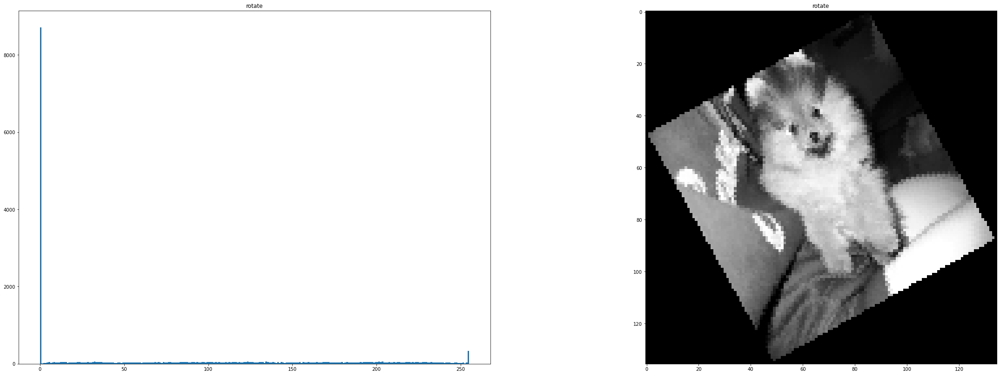

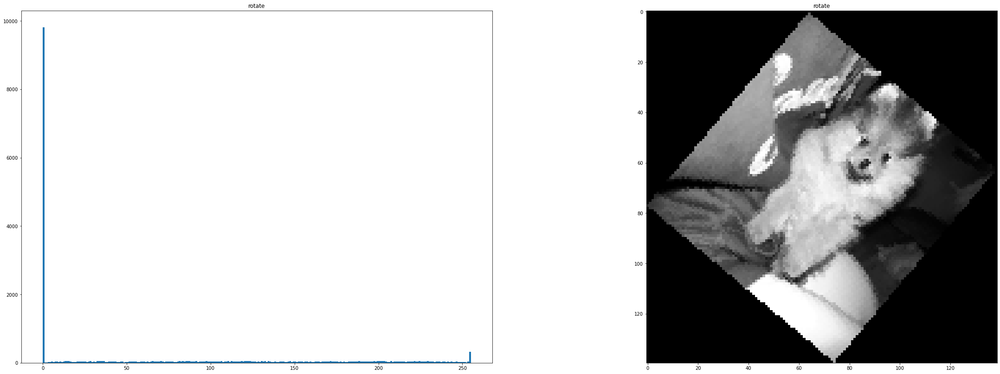

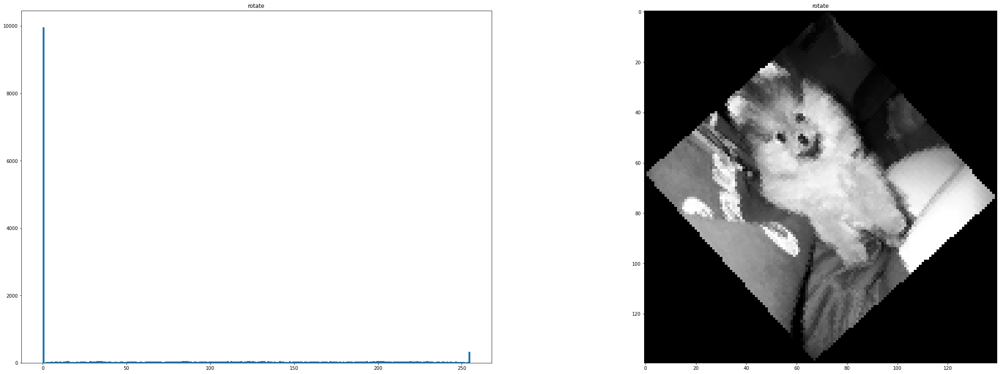

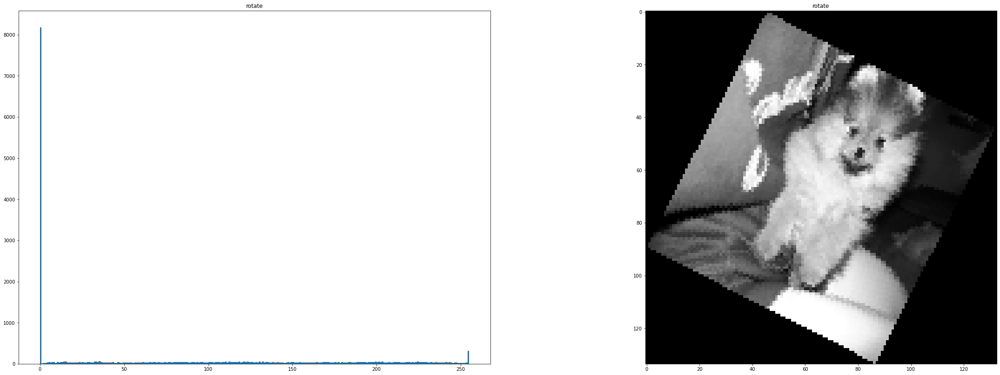

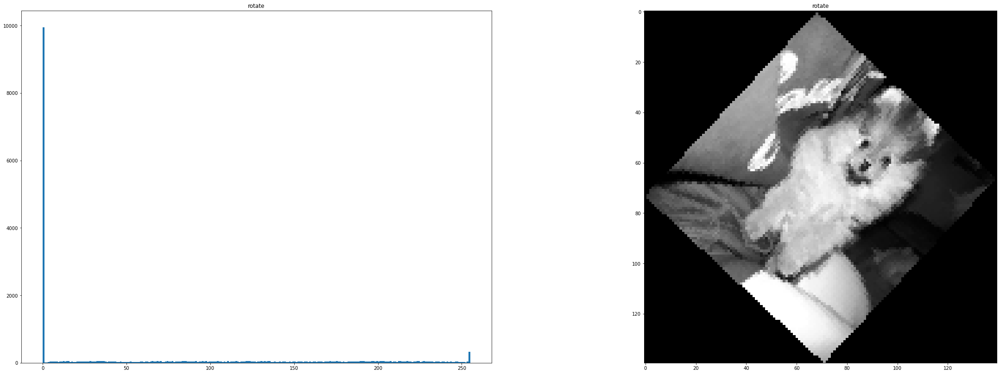

[(97, 100), (97, 100), (97, 100), (97, 100), (97, 100)]


In [57]:
WH, Imgs = rotate_n(res,5)
print(WH)

## flip

In [58]:
@check_histo
def transpose(img,m):
    flippedImg = img.transpose(method=m)
    return flippedImg

def transpose_n(img):
    imgs=[]
    sizeImgs=[]
    for m in [0,1,5,6 ]:   # 'FLIP_LEFT_RIGHT','FLIP_TOP_BOTTOM', 'TRANSPOSE', 'TRANSVERSE'
        Fimg = transpose(img,m)
        imgs.append(Fimg)
        sizeImgs.append((Fimg.width, Fimg.height))
    return sizeImgs ,imgs
        
    

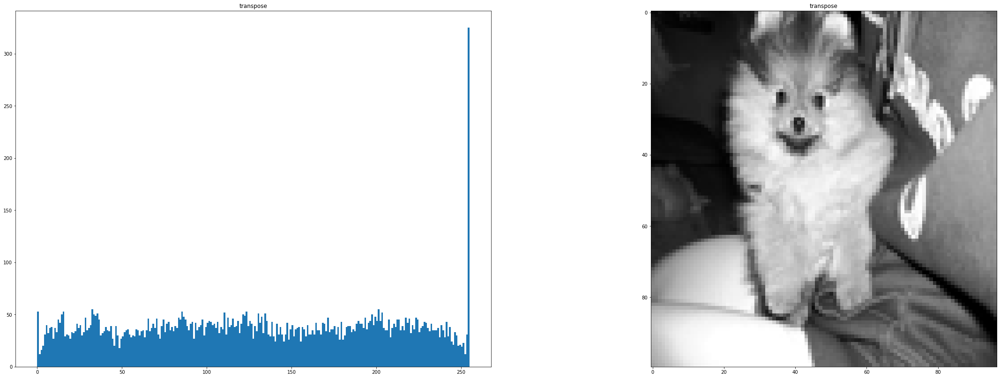

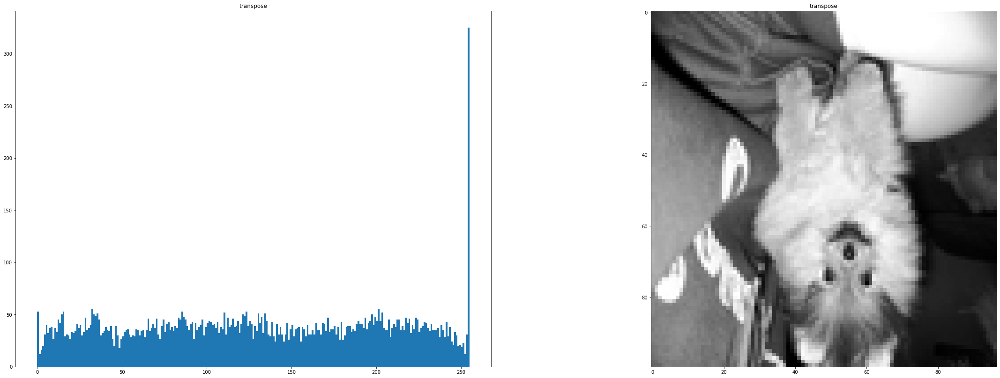

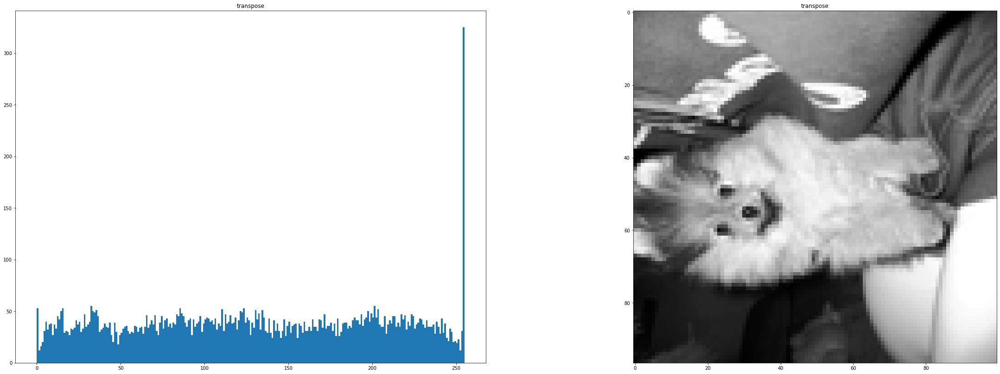

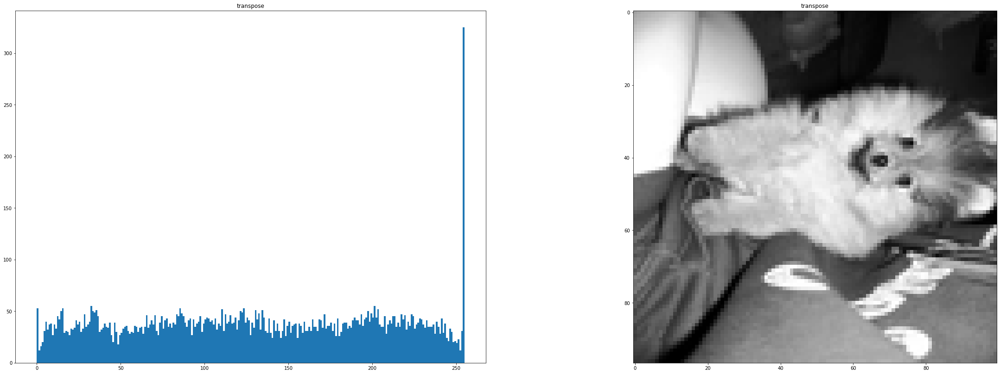

[(97, 100), (97, 100), (100, 97), (100, 97)]


In [59]:
WH, Imgs = transpose_n(res)
print(WH)

## test processing

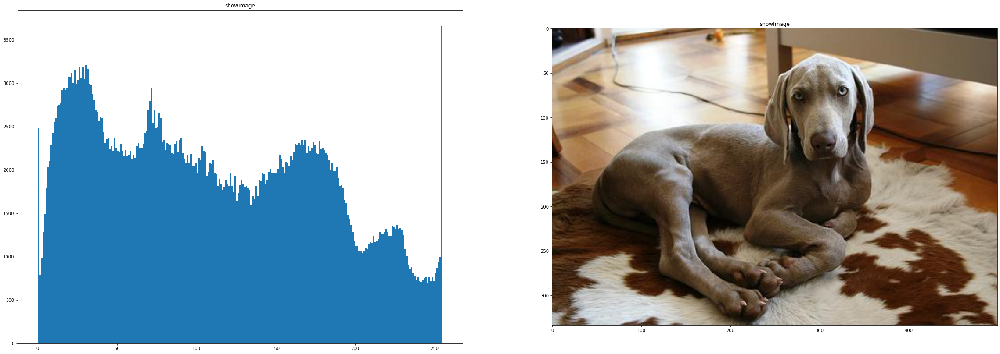

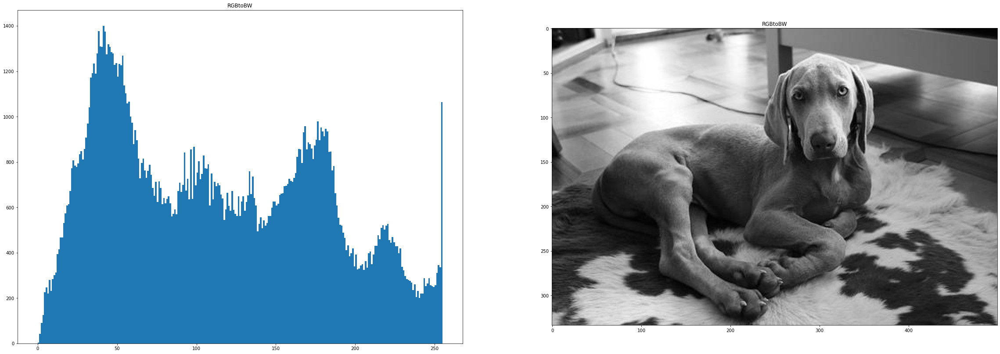

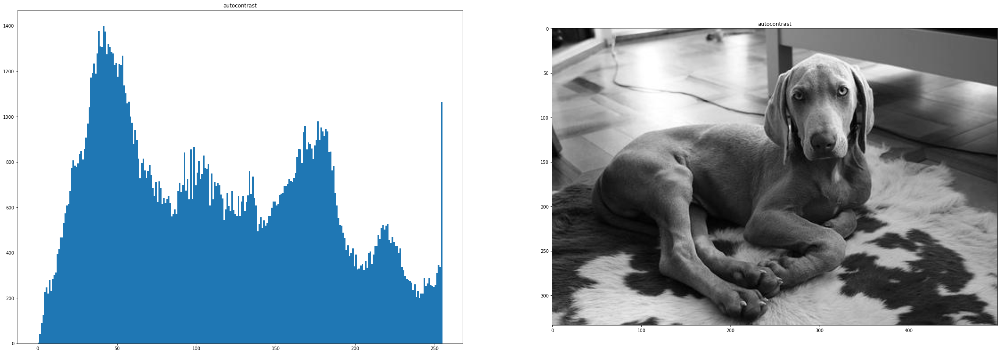

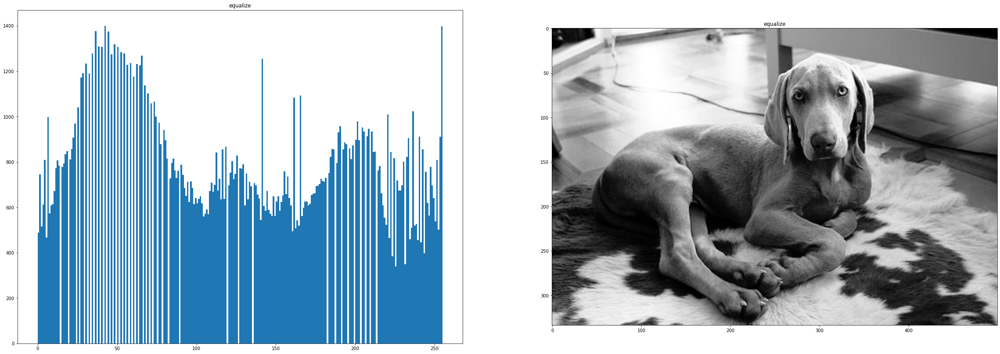

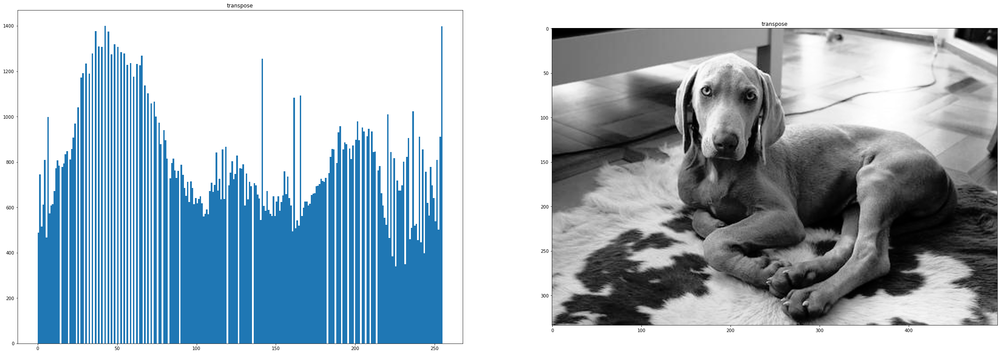

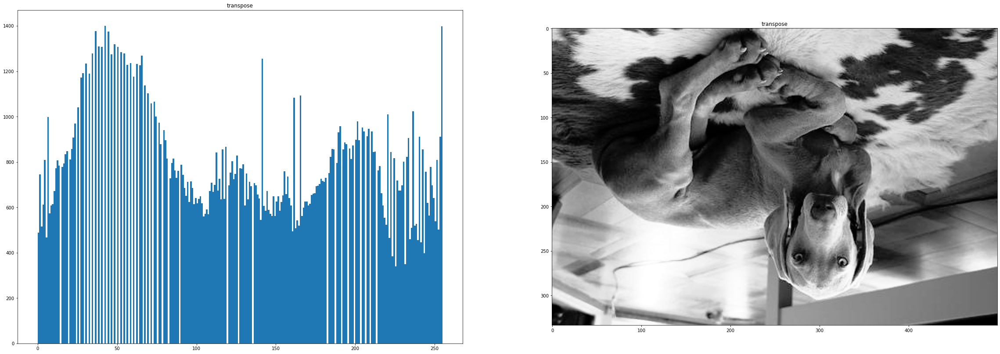

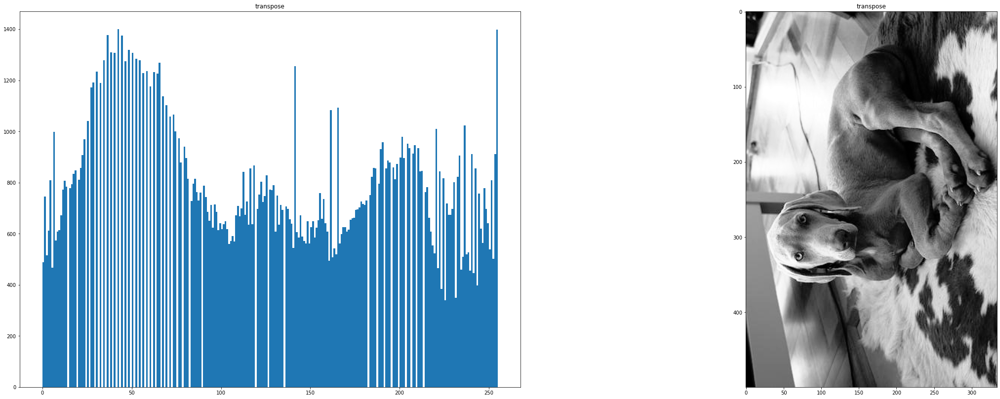

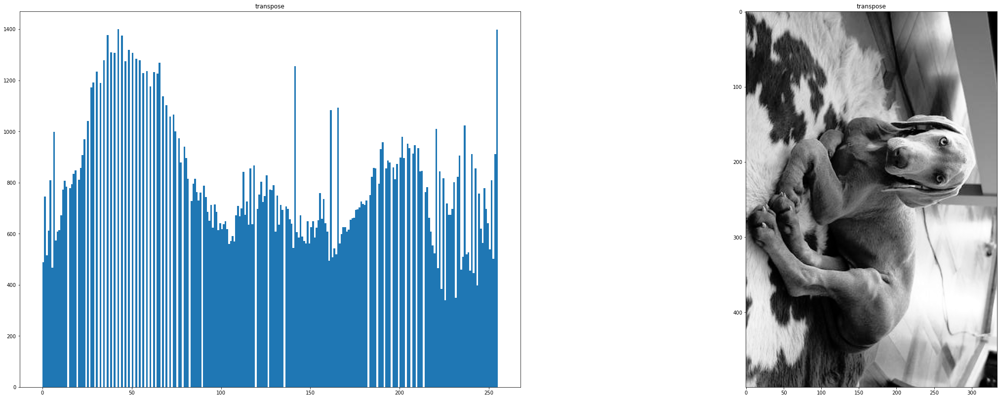

[(500, 334), (500, 334), (334, 500), (334, 500)]


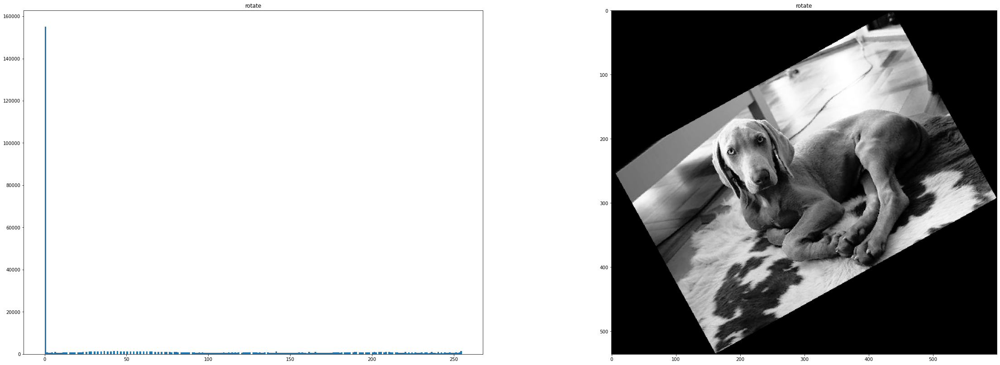

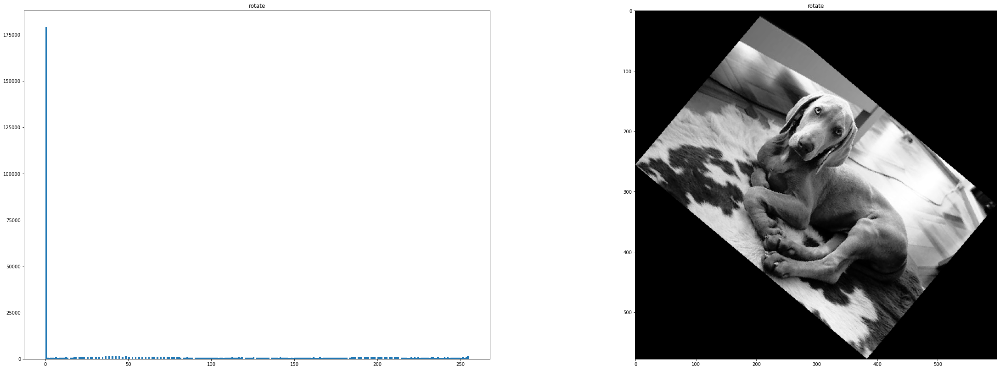

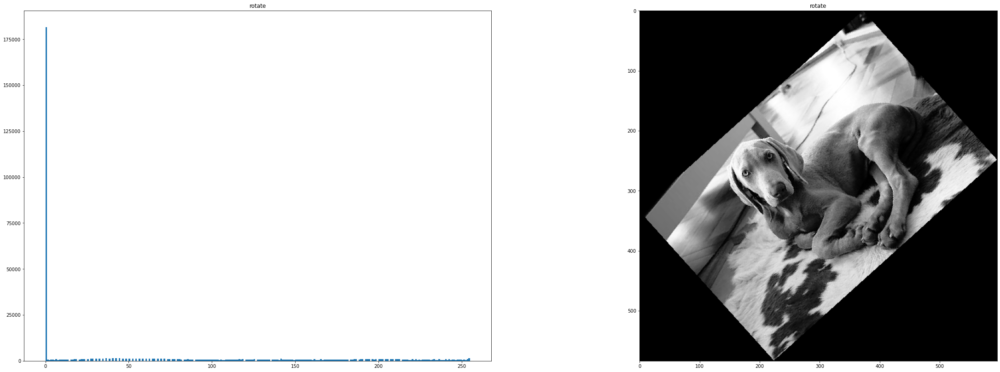

[(500, 334), (500, 334), (500, 334)]


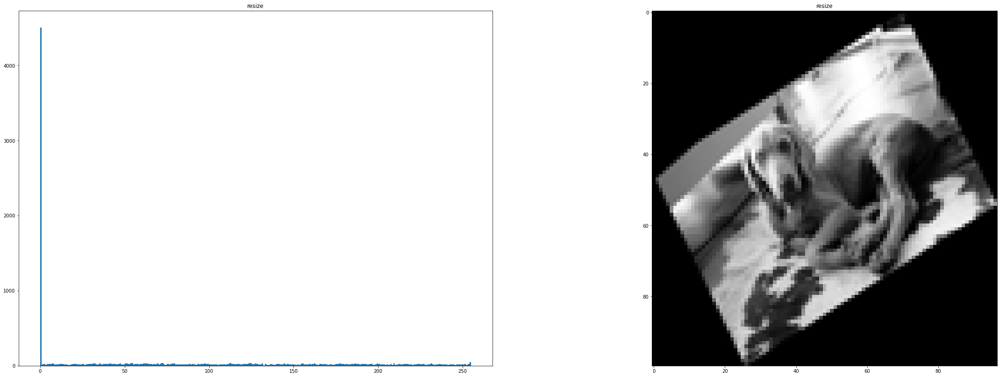

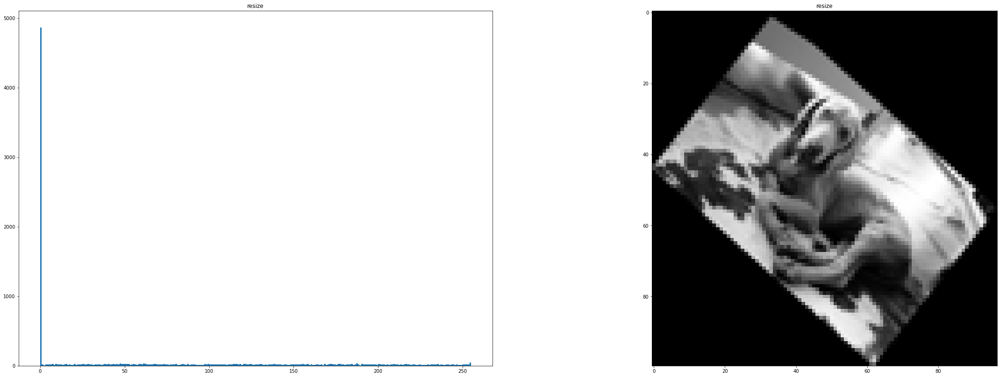

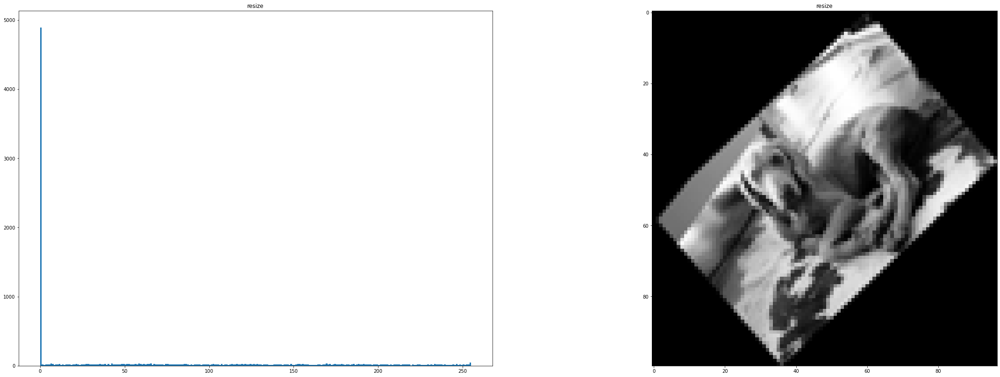

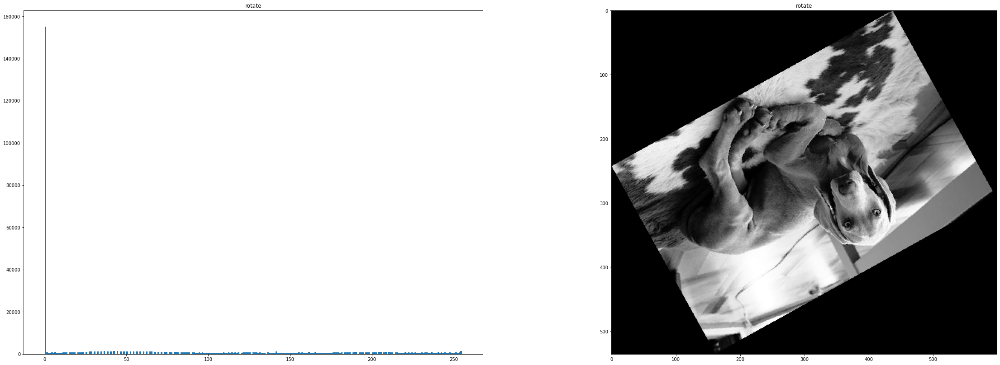

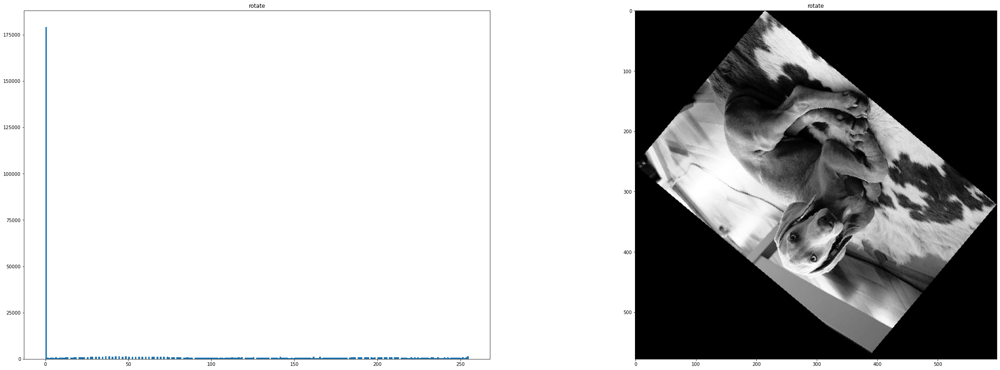

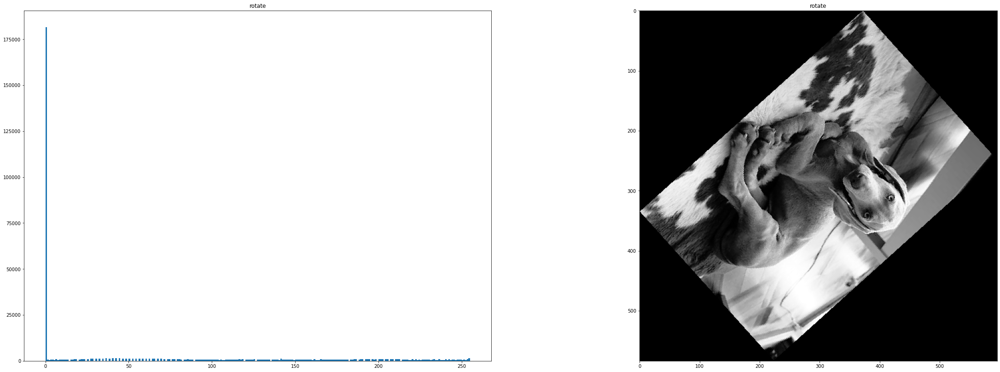

[(500, 334), (500, 334), (500, 334)]


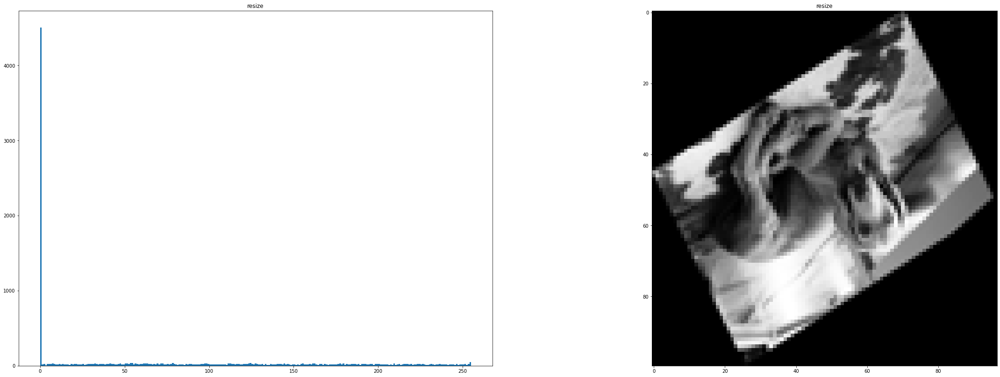

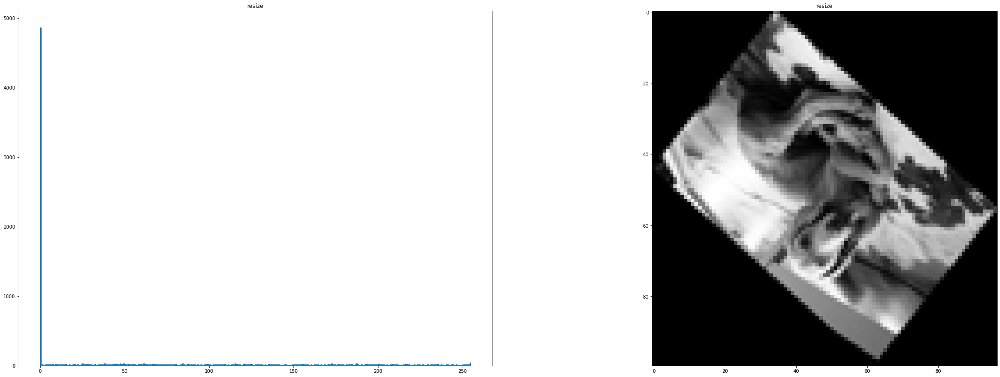

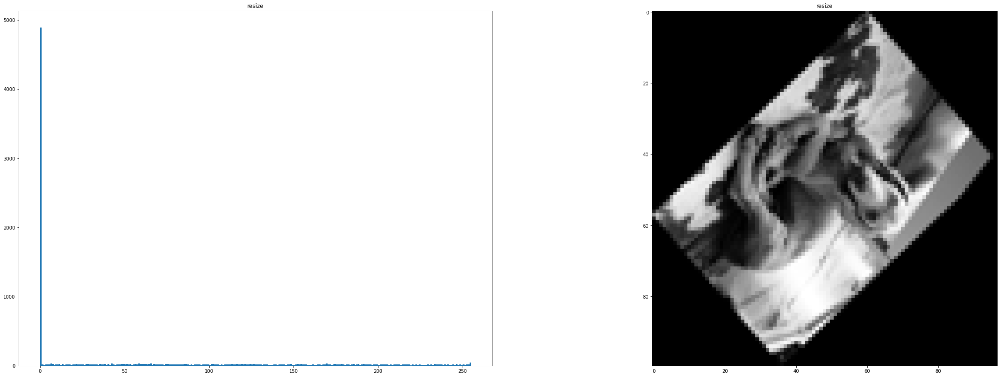

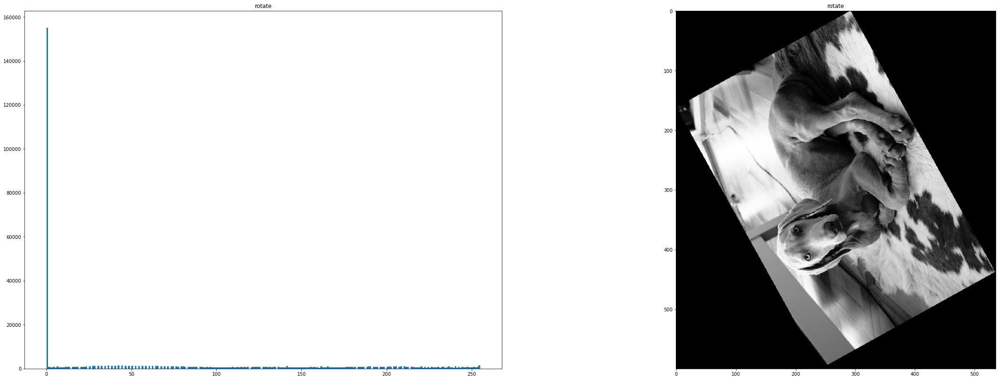

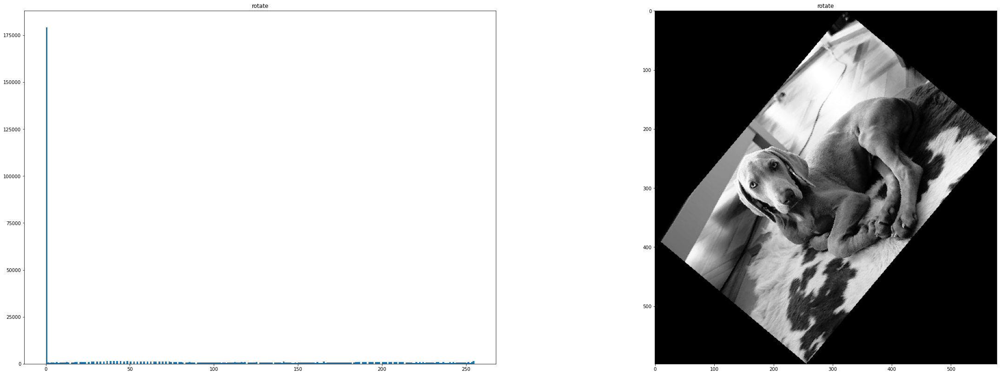

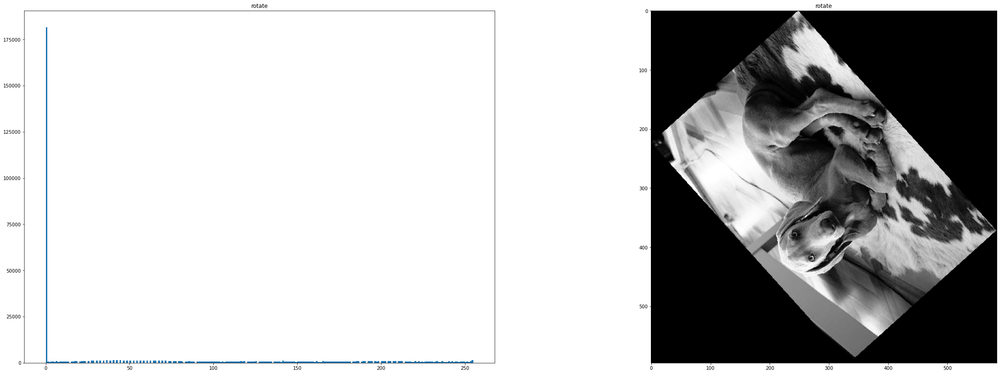

[(334, 500), (334, 500), (334, 500)]


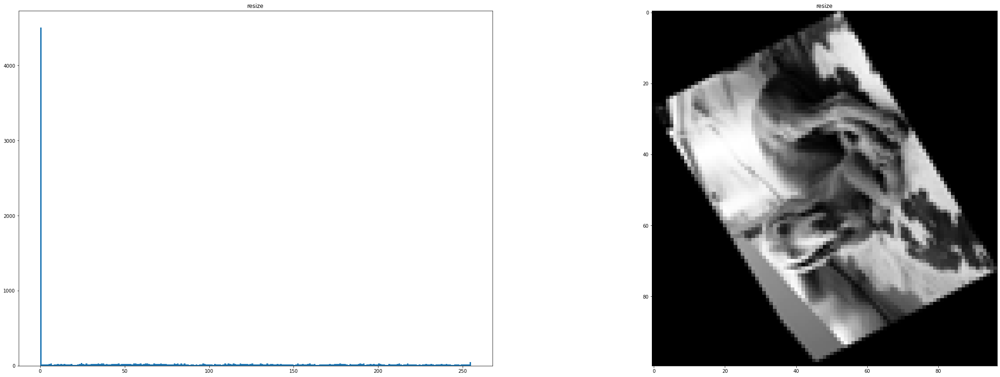

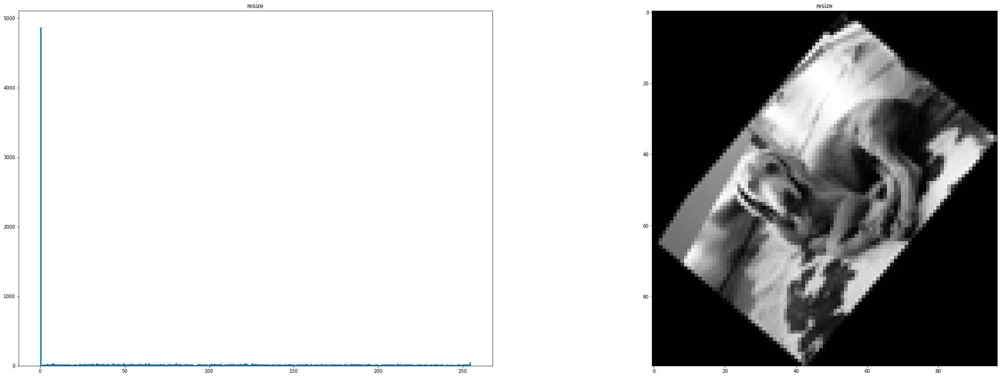

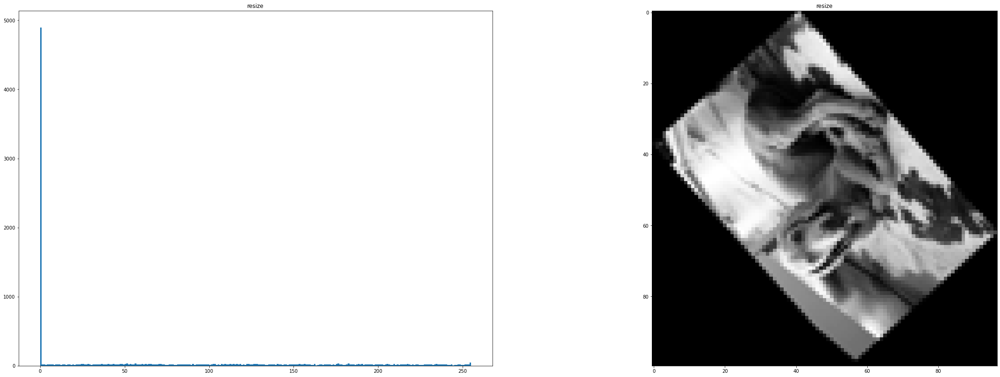

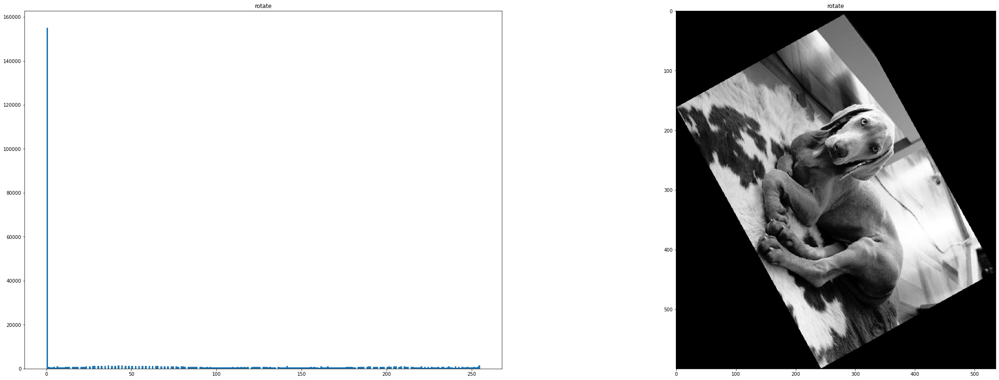

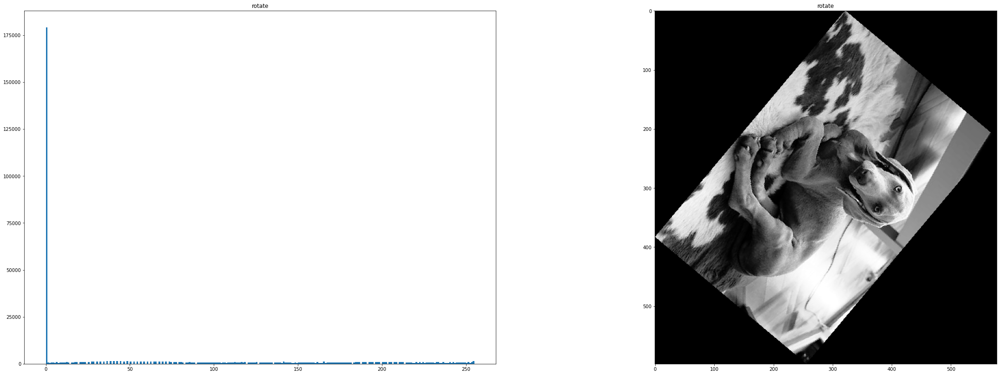

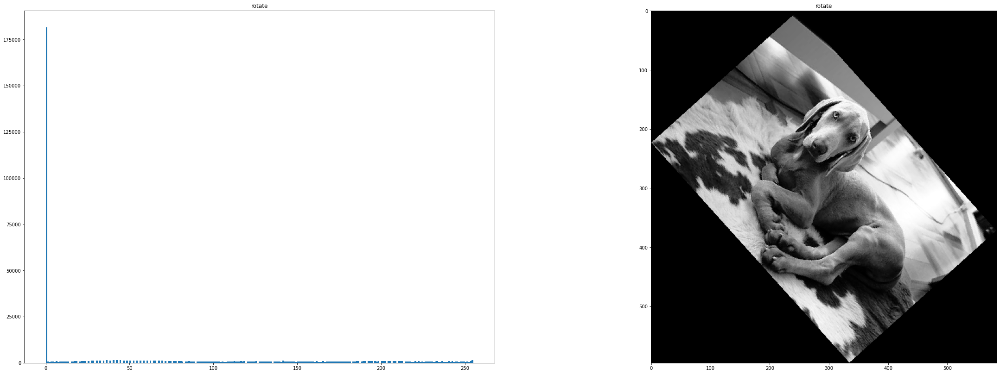

[(334, 500), (334, 500), (334, 500)]


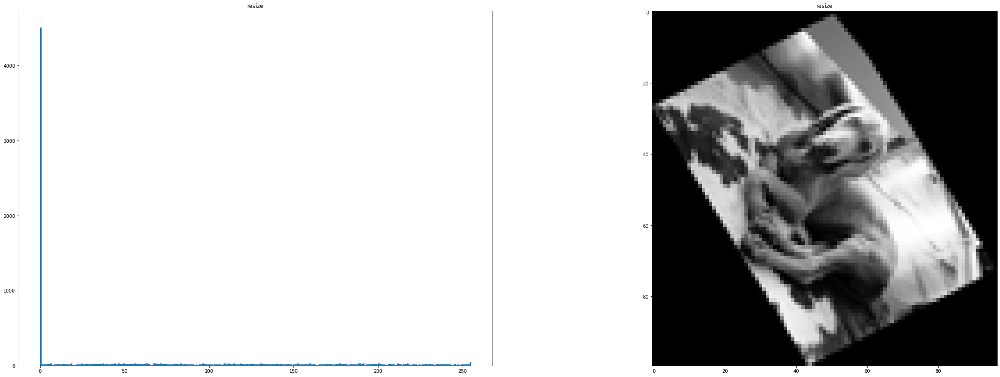

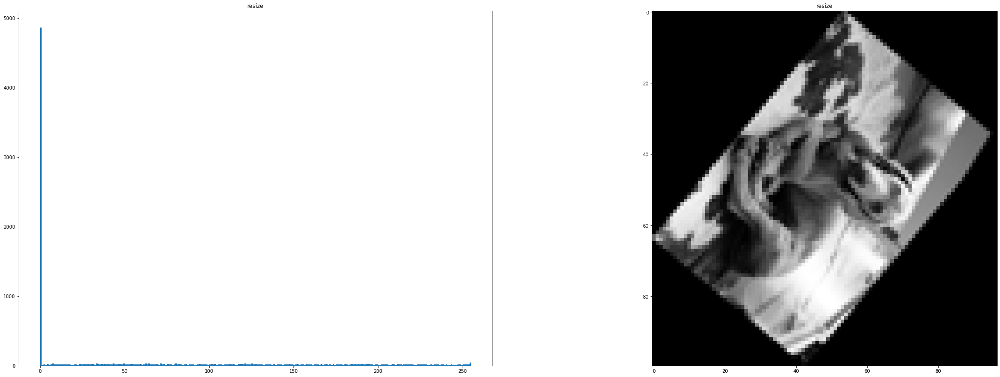

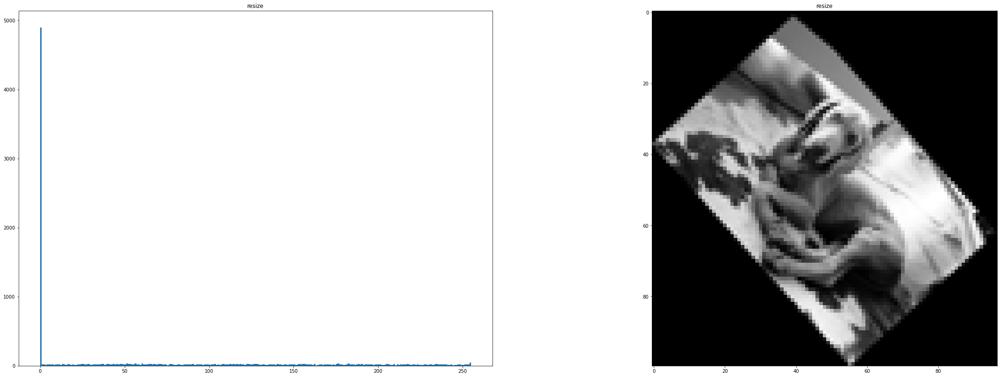

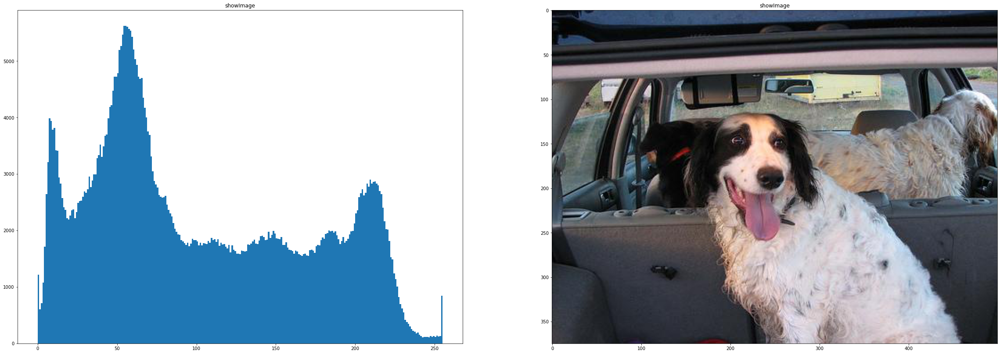

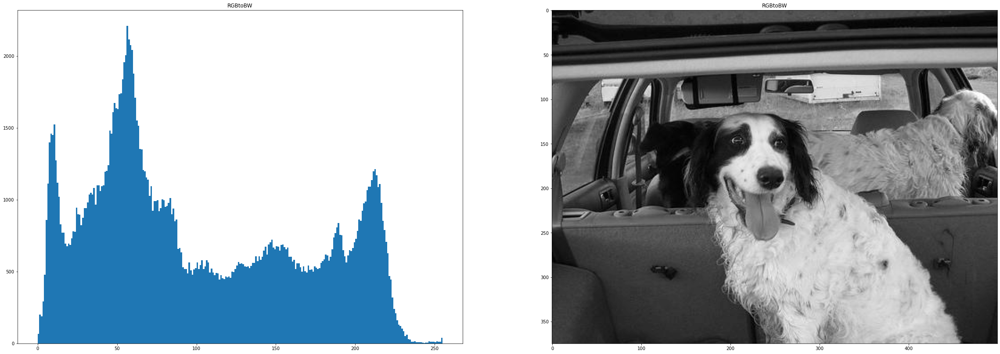

...

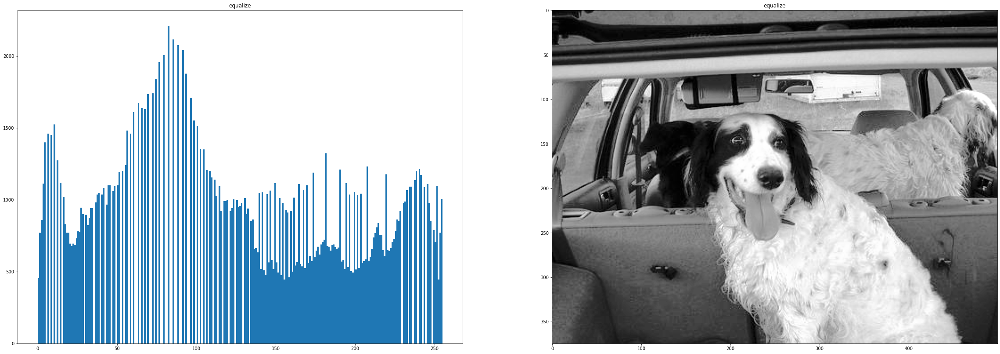

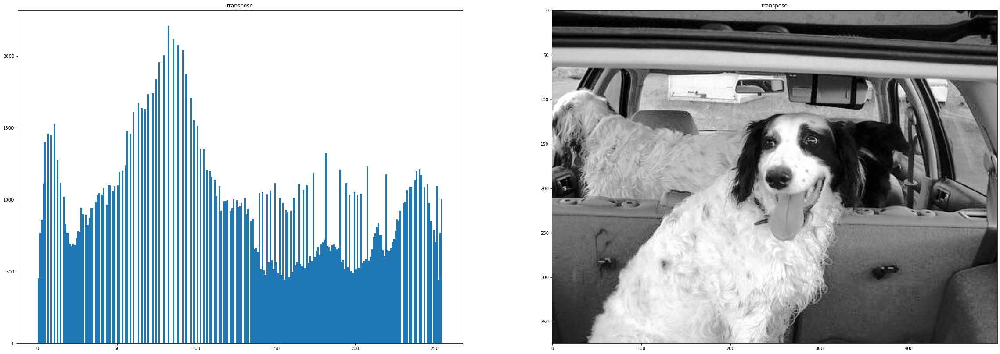

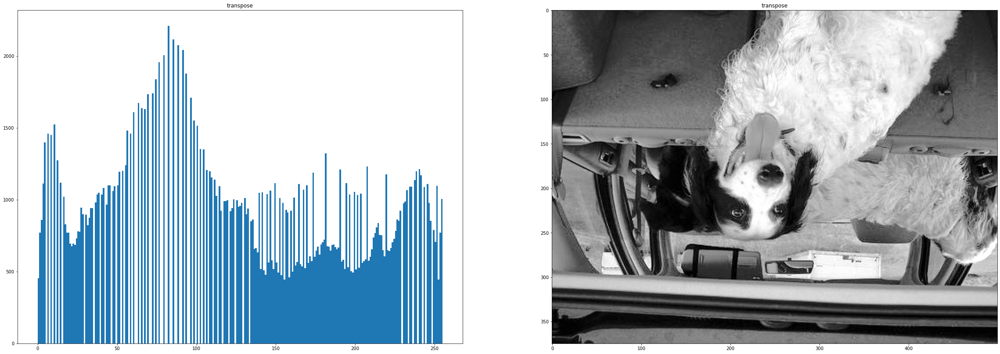

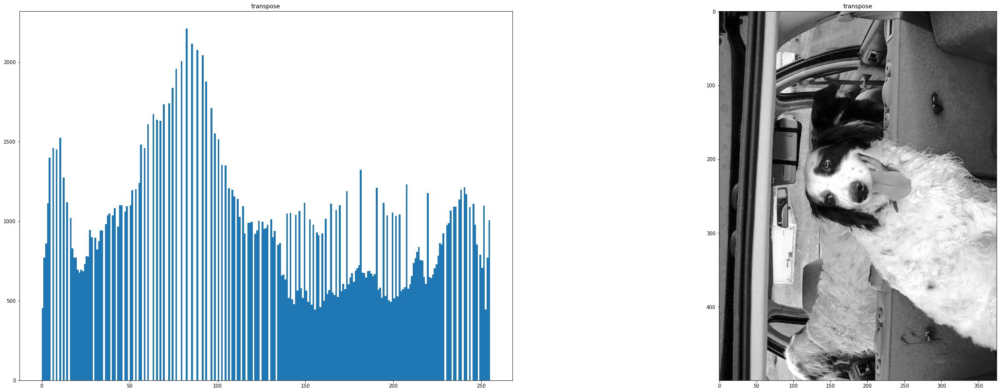

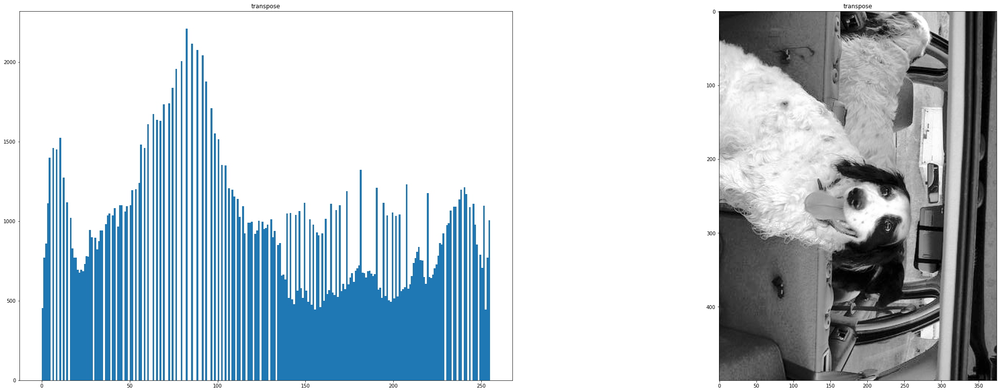

[(500, 375), (500, 375), (375, 500), (375, 500)]


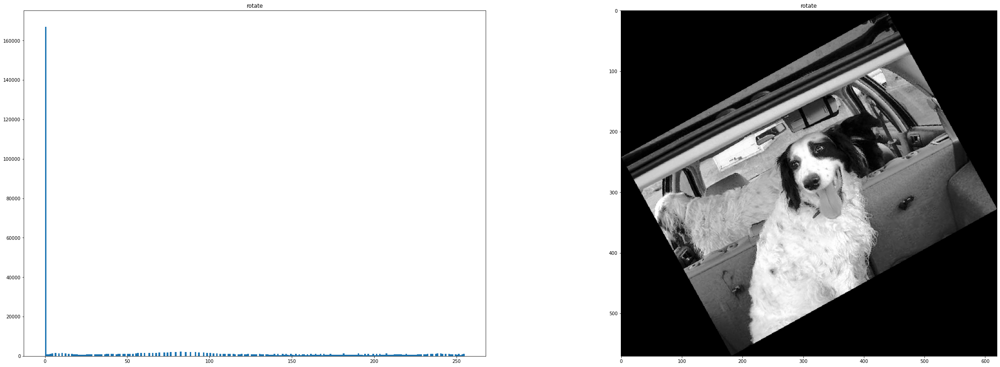

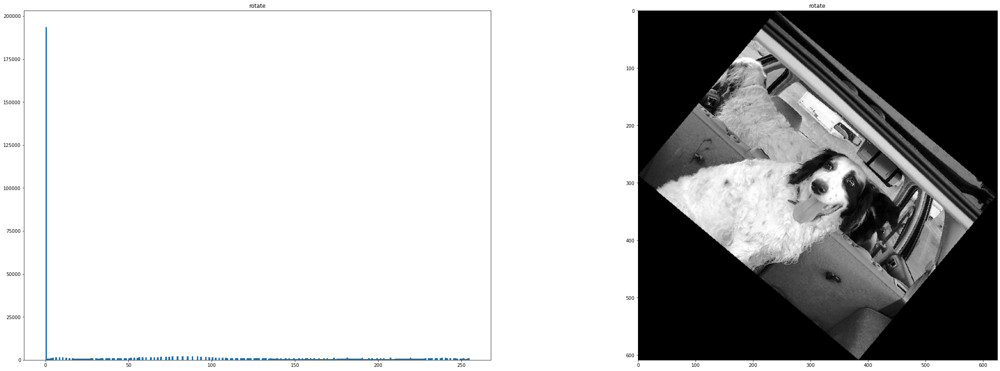

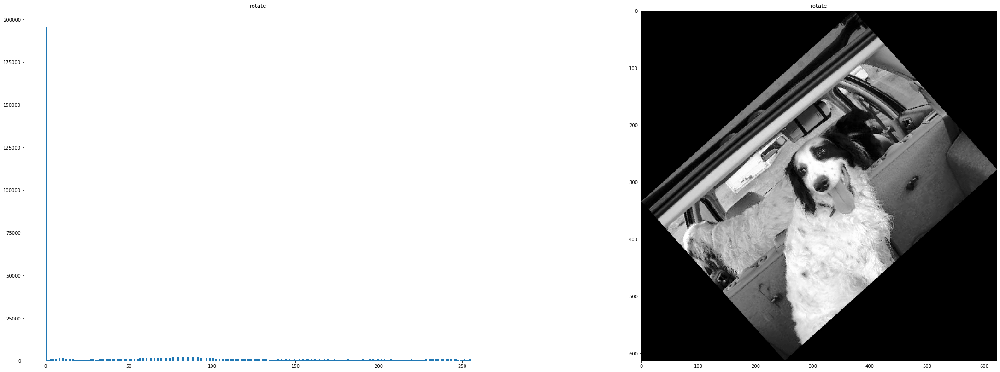

[(500, 375), (500, 375), (500, 375)]


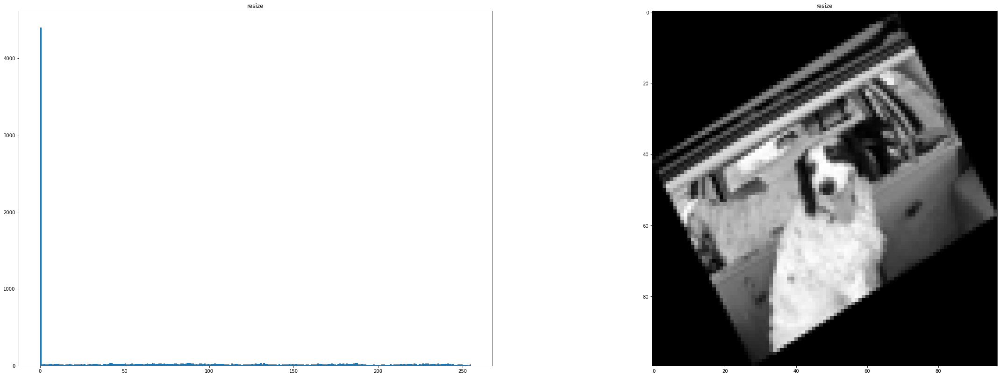

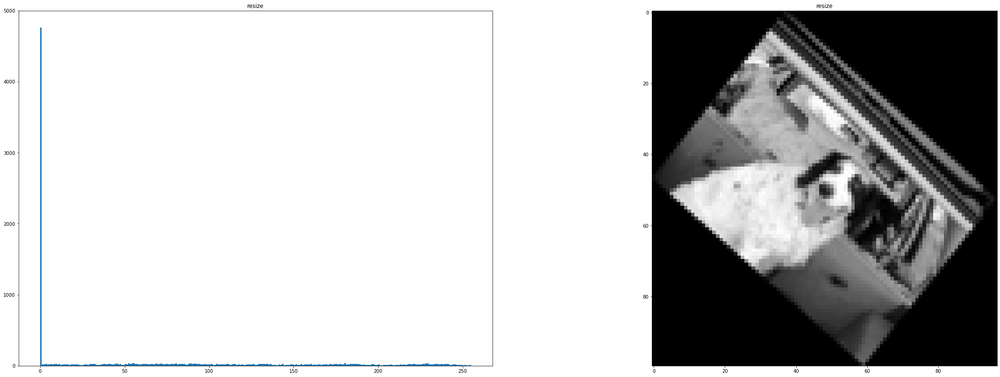

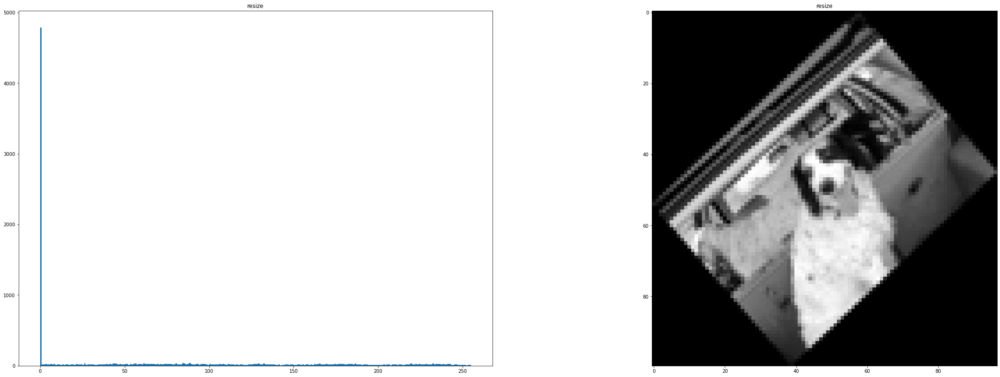

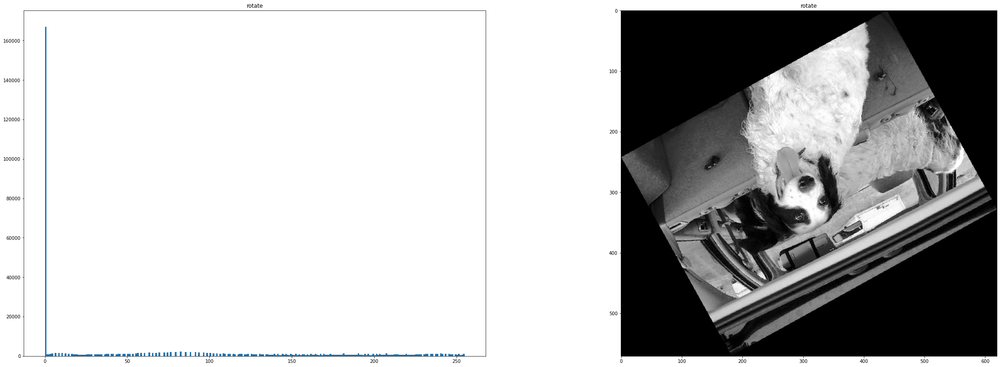

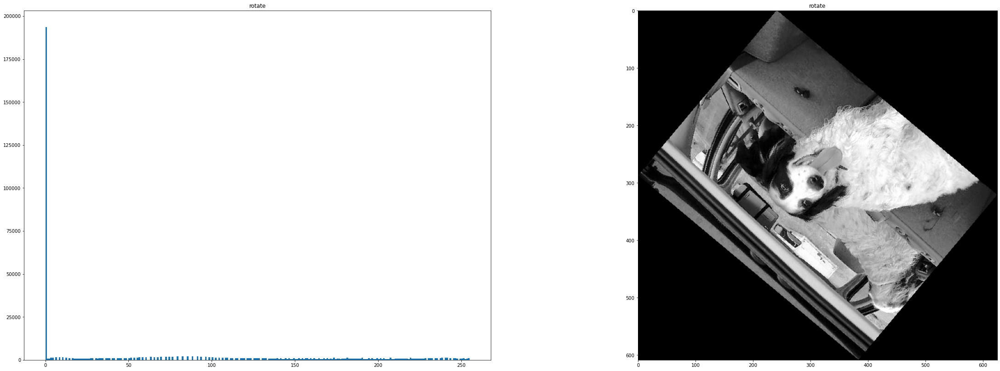

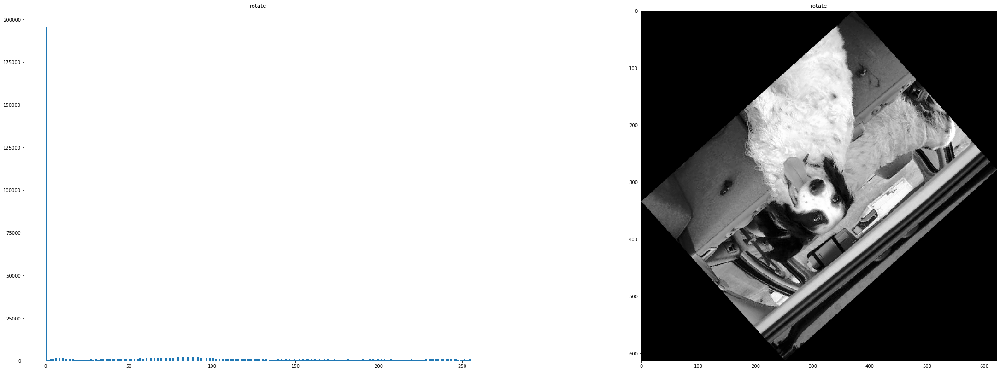

[(500, 375), (500, 375), (500, 375)]


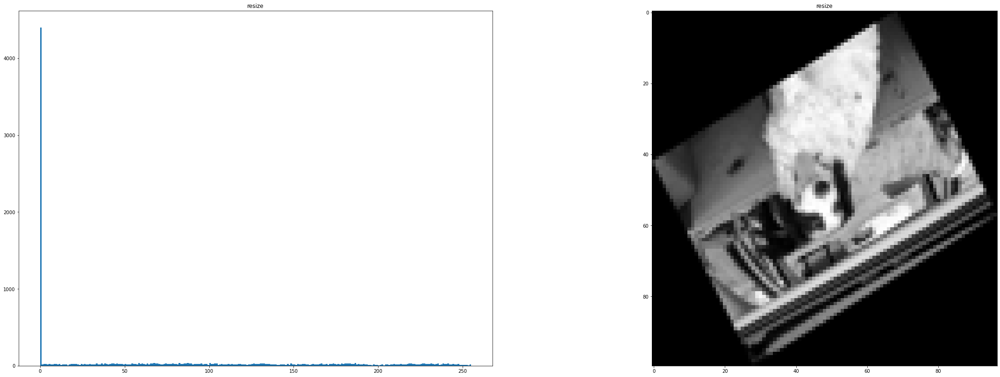

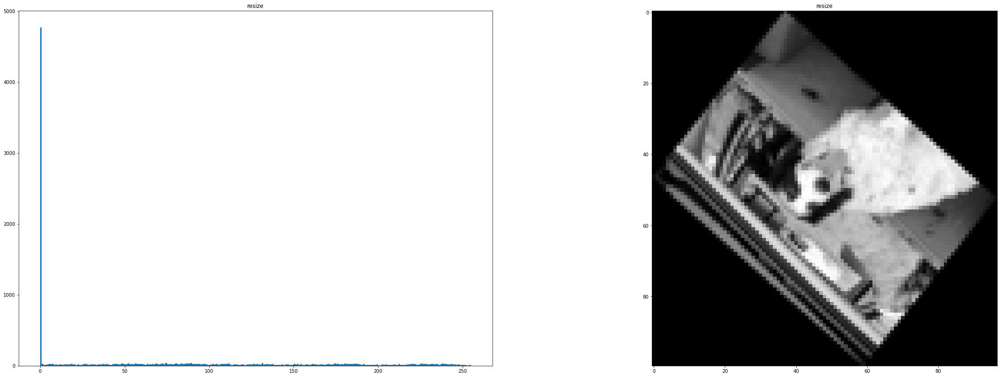

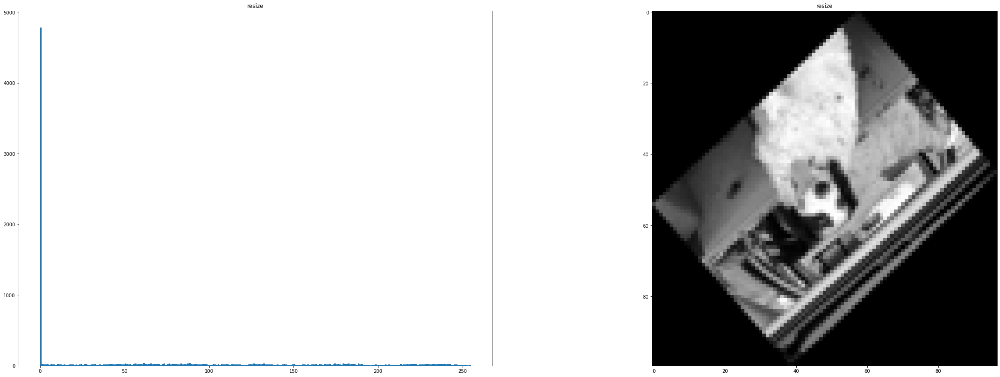

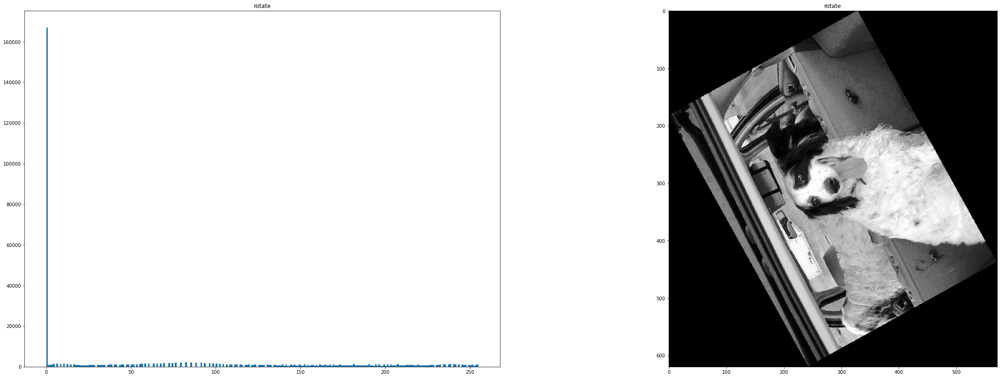

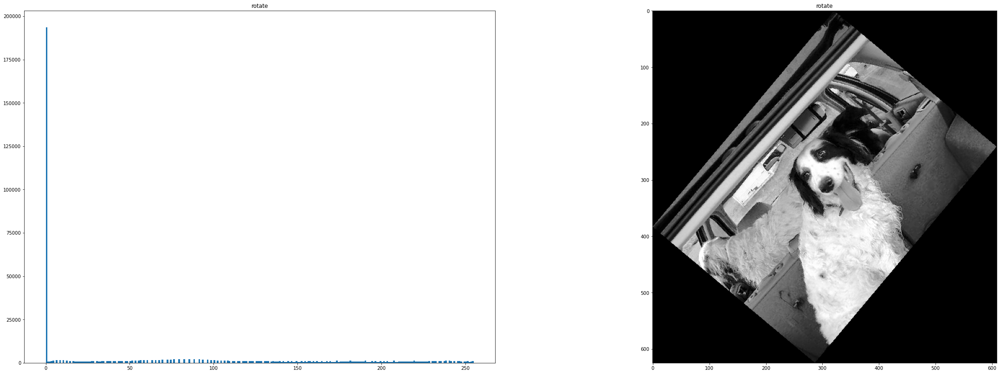

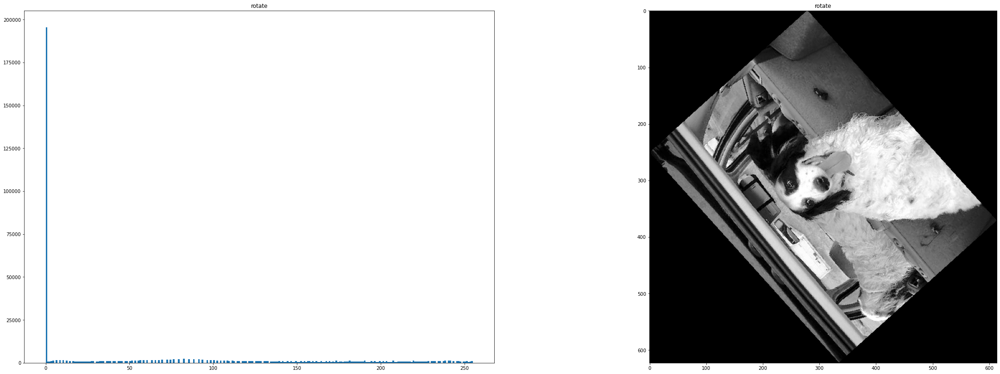

[(375, 500), (375, 500), (375, 500)]


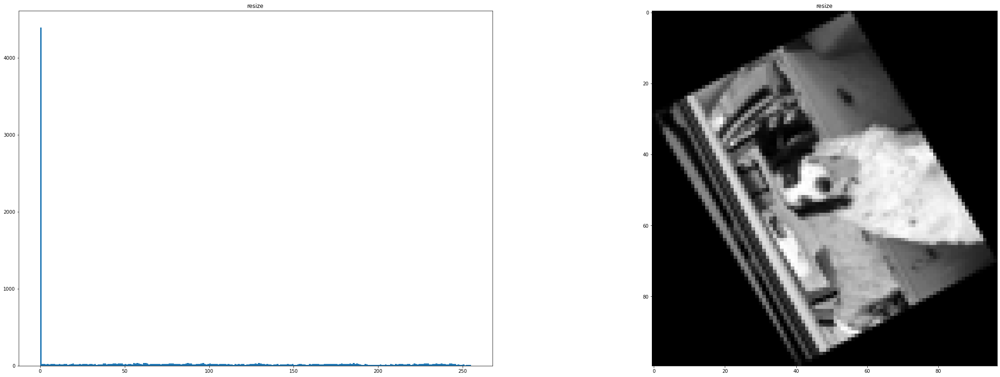

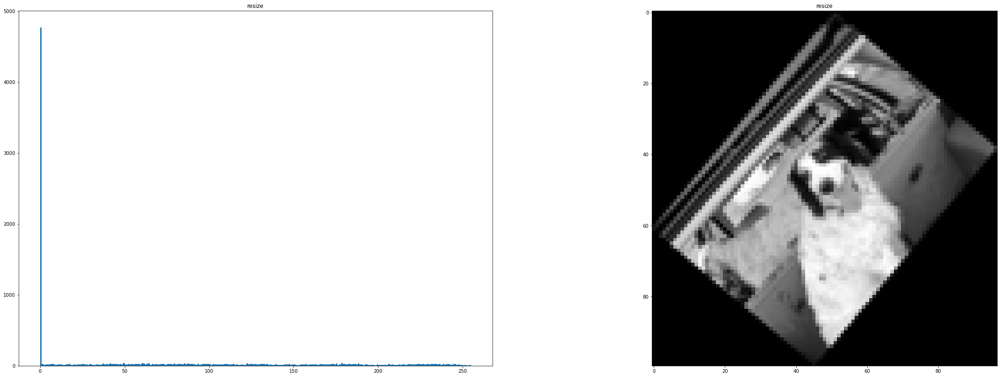

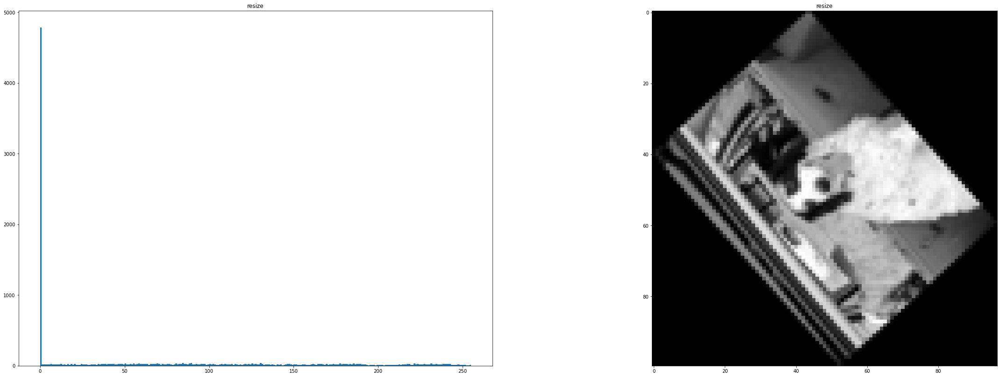

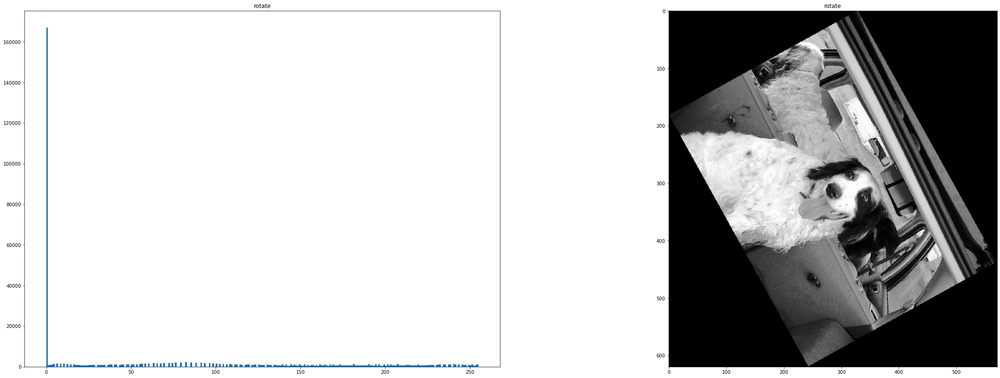

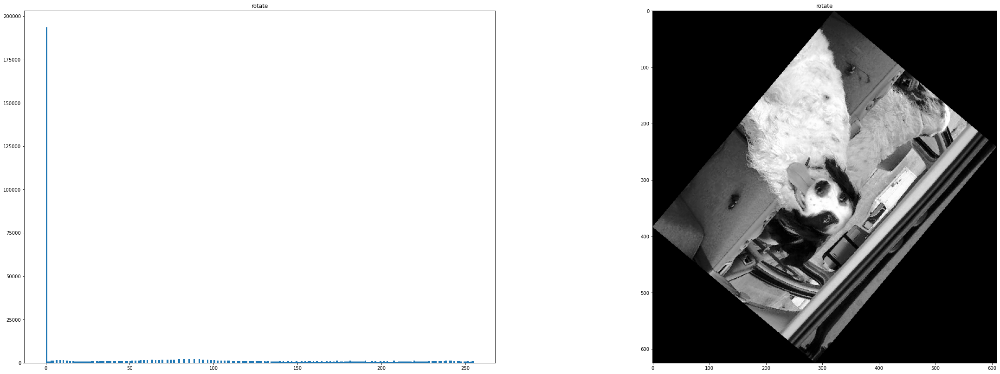

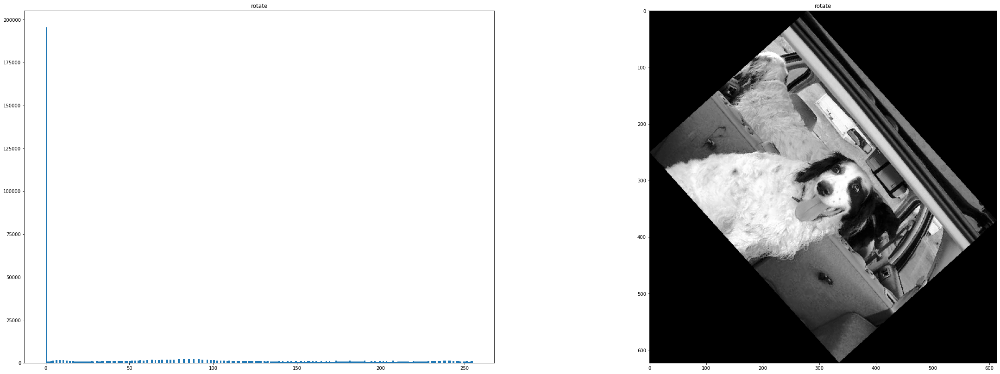

[(375, 500), (375, 500), (375, 500)]


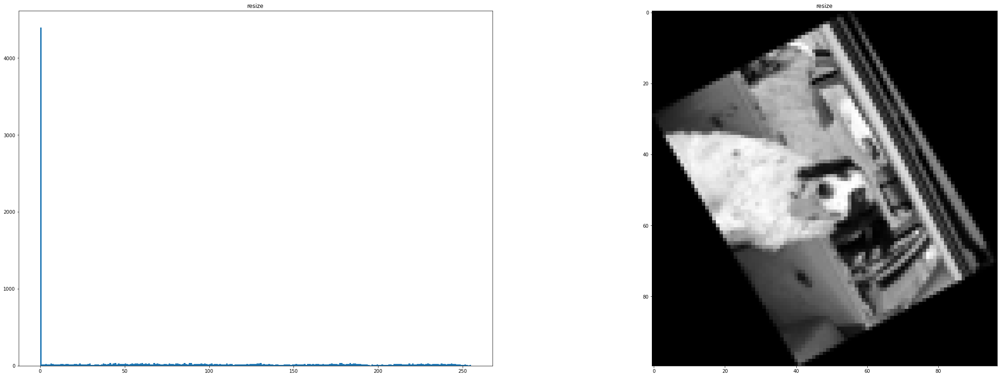

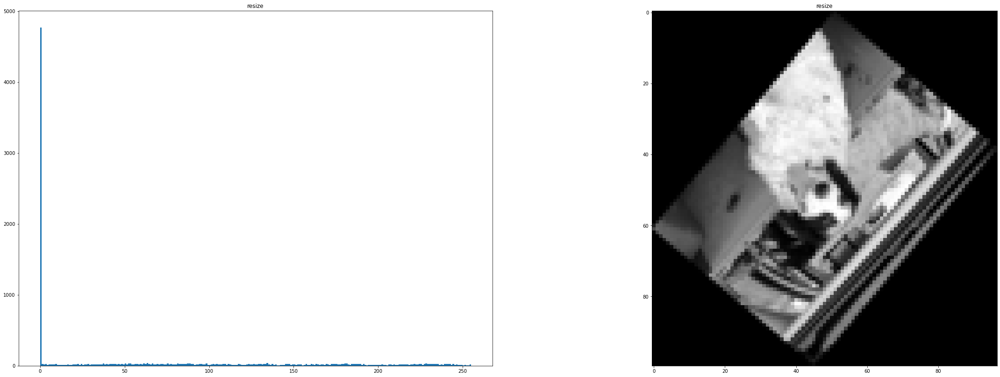

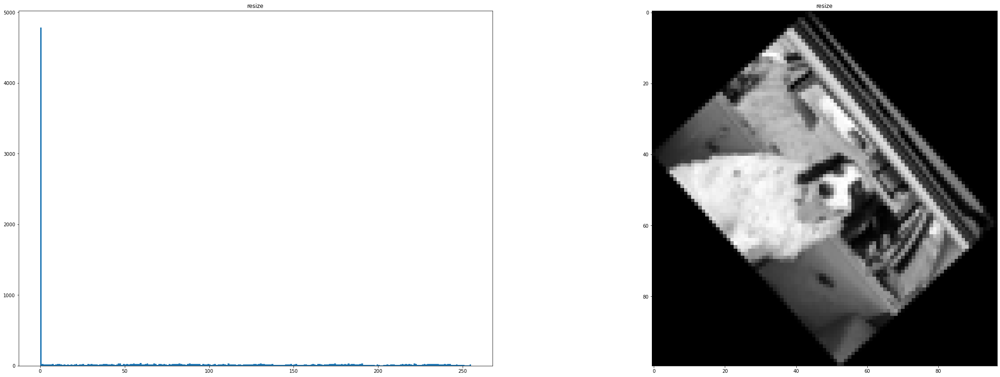

In [60]:
sample=df['path'].sample(2)
imgs = []
for i in sample:
    img = Image.open(i)
    showImage(img)
    res=RGBtoBW(img)
    res=autocontrast(res)
    res = equalize(res)
    WH, ImagesT = transpose_n(res)
    print(WH)
    for j in ImagesT:
        WH, ImgsR = rotate_n(j,3)
        print(WH)
        for k in ImgsR:
            res = resize(k, minW,minH)
            imgs.append(res)
    

## Create Image directories for keras results

We only keep 10 dogs race to train our AI, In order to simplify it to have a proof of concept. We use the 10  races which have the most images in the database.

In [61]:
labels = df['label'].unique()
# top of the file
import os
import errno

labelToKeep =df.value_counts('label').index.values[:10]

for i in labelToKeep:
    pathResTrain = pathKerasTrain10 + i
    pathResTest = pathKerasTest10 + i
    pathResVal = pathKerasVal10 + i
    try:
        os.makedirs(pathResTrain)
        os.makedirs(pathResTest)
        os.makedirs(pathResVal)
    except OSError as exc: 
        if exc.errno == errno.EEXIST and os.path.isdir(pathResTrain) and os.path.isdir(pathResTest) and os.path.isdir(pathResVal):
            pass



## Create Keras Images 

we choose to keep only the images which are above 259 pixels height and 288 pixels width. Those numbers correspond to the 10% quantiles

In [62]:
minHeight = 259
minWidth = 288
data = df[ (df['height']>=minHeight) & (df['width']>=minWidth)]
print(f"ratio data loss : {(df.shape[0] - data.shape[0])/df.shape[0]*100:.1f}   total number of images: {data.shape[0]}")

ratio data loss : 13.2   total number of images: 17870


In [63]:
labelToKeep =df.value_counts('label').index.values[:10]
data = data[data['label'].isin(labelToKeep)]
print(f" number of images in 10 breeds: {data.shape[0]}") 

 number of images in 10 breeds: 2124


In [64]:
labelToKeep =df.value_counts('label').index.values[:10]
index_train = pd.Index([])
for i in labelToKeep:
    index_train_i = data[data['label']==i].sample(frac=0.7,random_state=0).index
    index_train = index_train.union(index_train_i)

train = data.loc[index_train,:]
#train = data.sample(frac=0.8,random_state=0)
val = data.drop(index_train)

index_test = pd.Index([])
for i in labelToKeep:
    index_test_i = val[val['label']==i].sample(frac=0.2,random_state=0).index
    index_test = index_test.union(index_test_i)
    
test = val.loc[index_test,:]
val = val.drop(index_test)
print(f" train set shape: {train.shape} \n validation set shape: {val.shape} \n test set shape: {test.shape}")
print(f"number of images for 10 breeds after selection:{train.shape[0]+val.shape[0]+test.shape[0]}")

 train set shape: (1486, 8) 
 validation set shape: (510, 8) 
 test set shape: (128, 8)
number of images for 10 breeds after selection:2124


In [65]:
len(train['label'].unique()) == len(test['label'].unique())

True

<AxesSubplot: ylabel='label'>

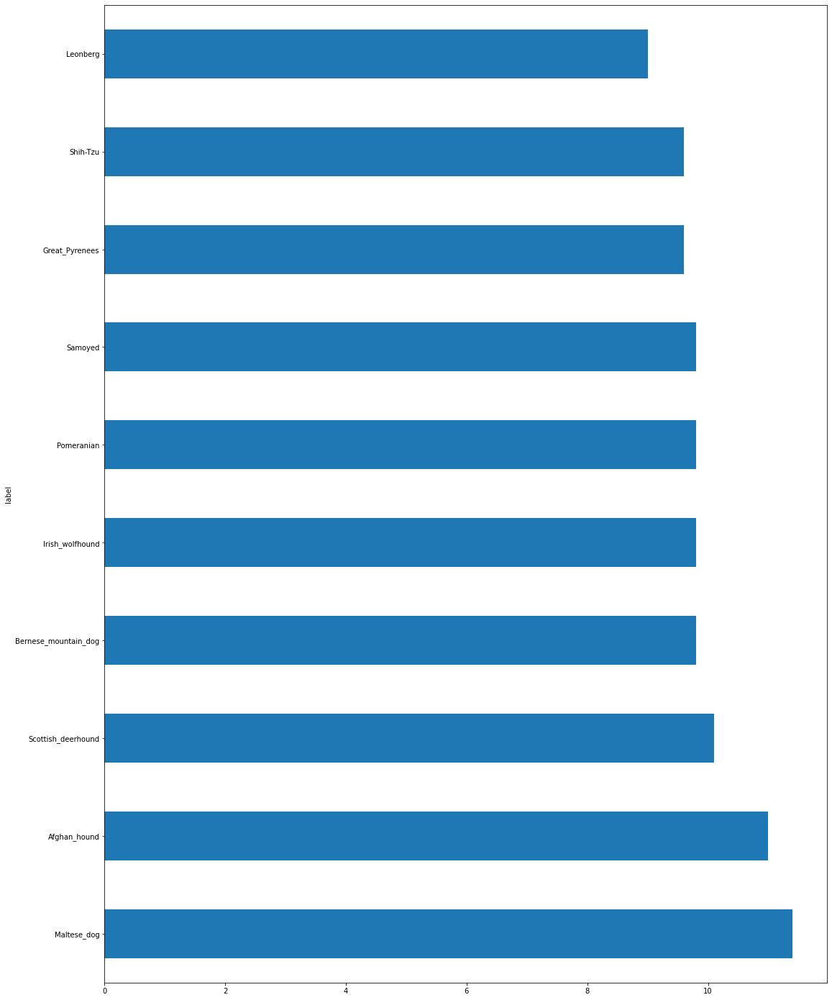

In [66]:
plt.rcParams["figure.figsize"] = [18, 25]
plotLabel = train.value_counts('label',normalize=True).mul(100).round(1)
plotLabel.plot(kind='barh')

<AxesSubplot: ylabel='label'>

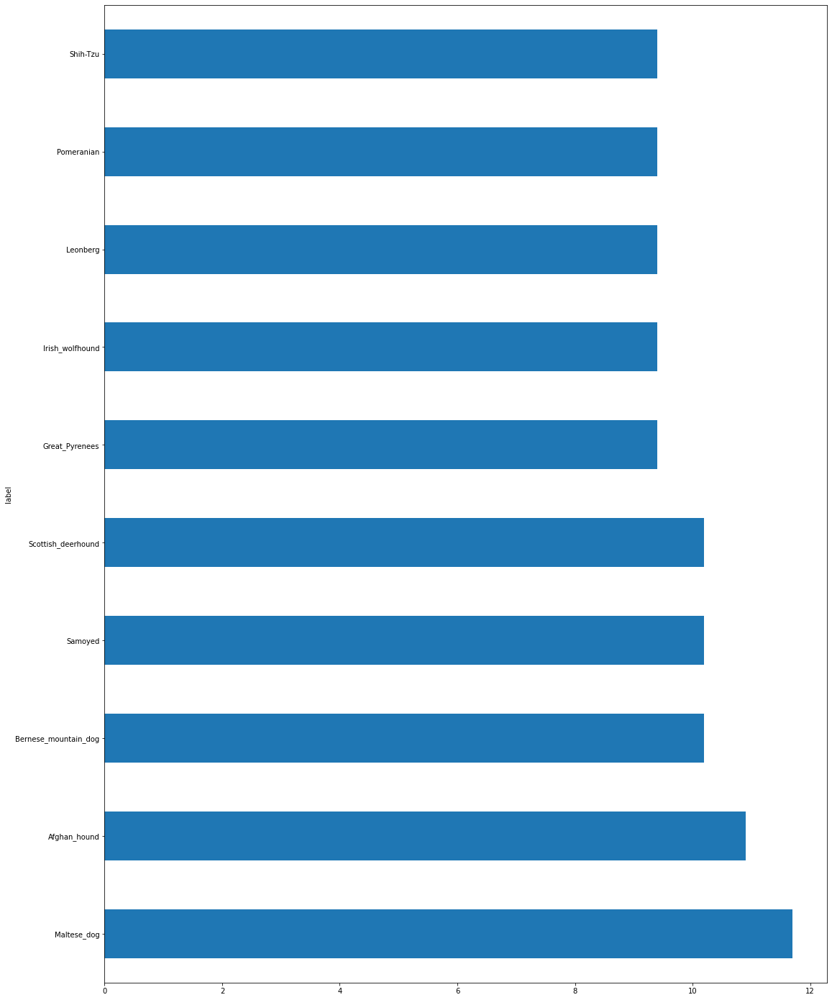

In [67]:
plt.rcParams["figure.figsize"] = [18, 25]
plotLabel = test.value_counts('label',normalize=True).mul(100).round(1)
plotLabel.plot(kind='barh')

## Functions

In [68]:
def transpose(img,m):
    flippedImg = img.transpose(method=m)
    return flippedImg

def transpose_n(img):
    imgs=[]
    sizeImgs=[]
    for m in [0,1,5,6 ]:   # 'FLIP_LEFT_RIGHT','FLIP_TOP_BOTTOM', 'TRANSPOSE', 'TRANSVERSE'
        Fimg = transpose(img,m)
        imgs.append(Fimg)
        sizeImgs.append((Fimg.width, Fimg.height))
    return sizeImgs ,imgs

#def transpose_n(img):
#    imgs=[]
#    sizeImgs=[]
#    transposition_label = [0,1,5,6 ] # 'FLIP_LEFT_RIGHT','FLIP_TOP_BOTTOM', 'TRANSPOSE', 'TRANSVERSE'
#    rng = np.random.default_rng(12345)
#    rint = rng.integers(low=0, high=5, size=1) # uniform distribution
#    rint = rint.item(0) # convert to a scalar
#    m = transposition_label[rint]
#    Fimg = transpose(img,m)
#    imgs.append(Fimg)
#    sizeImgs.append((Fimg.width, Fimg.height))
#    return sizeImgs ,imgs

In [69]:
def rotate(img,angle):
    rotatedImg = img.rotate(angle, expand=True, center=(img.width // 2, img.height // 2), fillcolor=(0))# black color doesn't infer in backtracking
    return rotatedImg

def rotate_n(img,nb):
    rng = np.random.default_rng(12345)
    rints = rng.integers(low=-72, high=73, size=nb) # uniform distribution
    sizeImgs=[]
    Imgs =[]
    for i in rints:
        Rimg = rotate(img,i)
        sizeImgs.append((img.width, img.height))
        Imgs.append(Rimg)
    return sizeImgs, Imgs

In [70]:

def showImage(img):
    return img


def RGBtoBW(img):
    imgMono = img.convert(mode='L', matrix=None, dither=None, palette=None, colors=256)
    return imgMono


def autocontrast(img):
    rimg = ImageOps.autocontrast(img)
    return rimg


def equalize(img):
    rimg = ImageOps.equalize(img)
    return rimg

def resize(img,width,height):
    resizedImg = img.resize((width,height))
    return resizedImg

## data augmentation

In [71]:
# train processing
labels = df['label'].unique()
nb_rotation = 3 #2

labelToKeep =df.value_counts('label').index.values[:10]

imgs = []
for label in labelToKeep:
    sample_data = train[train['label' ]== label]
    sample_data = sample_data['path']
    nb_label = 0
    for i in sample_data:
        #print(i)
        img = Image.open(i)
        res=RGBtoBW(img)
        res=autocontrast(res)
        res = equalize(res)
        WH, ImagesT = transpose_n(res)
        #print(WH) 
        for j in ImagesT:
            WH, ImgsR = rotate_n(j,nb_rotation)
            #print(WH)
            for k in ImgsR:
                res = resize(k, minWidth,minHeight)
                path_name = pathKerasTrain10 + label +'/'+ label +'_image' + str(nb_label) +'.jpg'
                imgs.append(path_name) # res , à enlever
                nb_label += 1
                if (res.width==288 and res.height==259):
                    res.save(path_name)
                    pass
                else:
                    raise Exception(f"WH not correct {res.width} {res.height}")
                    
print(f"number of images at the end of the train set processing: {len(imgs)}")

number of images at the end of the train set processing: 17832


In [72]:
train.shape[0]*4*nb_rotation # nb image  * nb_transpose * nb rotation

17832

In [73]:
#test processing
labelToKeep =df.value_counts('label').index.values[:10]

imgs = []
for label in labels:
    sample_data = test[test['label' ]== label]
    sample_data = sample_data['path']
    nb_label = 0
    for i in sample_data:
        #print(i)
        img = Image.open(i)
        res=RGBtoBW(img)
        res=autocontrast(res)
        res = equalize(res)
        res = resize(res, minWidth,minHeight)
        path_name = pathKerasTest10 + label +'/'+ label +'_image' + str(nb_label) +'.jpg'
        imgs.append(path_name) # res , à enlever
        nb_label += 1
        if (res.width==288 and res.height==259):
            res.save(path_name)
            pass
        else:
            raise Exception(f"WH not correct {res.width} {res.height}")
                    
print(f"number of images at the end of the test set processing: {len(imgs)}")

number of images at the end of the test set processing: 128


In [74]:
#validation processing
labelToKeep =df.value_counts('label').index.values[:10]

imgs = []
for label in labels:
    sample_data = val[val['label' ]== label]
    sample_data = sample_data['path']
    nb_label = 0
    for i in sample_data:
        #print(i)
        img = Image.open(i)
        res=RGBtoBW(img)
        res=autocontrast(res)
        res = equalize(res)
        res = resize(res, minWidth,minHeight)
        path_name = pathKerasVal10 + label +'/'+ label +'_image' + str(nb_label) +'.jpg'
        imgs.append(path_name) # res , à enlever
        nb_label += 1
        if (res.width==288 and res.height==259):
            res.save(path_name)
            pass
        else:
            raise Exception(f"WH not correct {res.width} {res.height}")
                    
print(f"number of images at the end of the test set processing: {len(imgs)}")

number of images at the end of the test set processing: 510


## Test Keras

In [75]:
ds =tf.keras.utils.image_dataset_from_directory(
    pathImages,
    
    color_mode='rgb',
    batch_size=32,
    image_size=(256, 256),
    shuffle=True,
    seed=None,
    validation_split=None,
    subset=None,
    interpolation='bilinear',
    follow_links=False,
    crop_to_aspect_ratio=False
)


Found 20580 files belonging to 120 classes.


In [76]:
class_names = ds.class_names
print(class_names)


['n02085620-Chihuahua', 'n02085782-Japanese_spaniel', 'n02085936-Maltese_dog', 'n02086079-Pekinese', 'n02086240-Shih-Tzu', 'n02086646-Blenheim_spaniel', 'n02086910-papillon', 'n02087046-toy_terrier', 'n02087394-Rhodesian_ridgeback', 'n02088094-Afghan_hound', 'n02088238-basset', 'n02088364-beagle', 'n02088466-bloodhound', 'n02088632-bluetick', 'n02089078-black-and-tan_coonhound', 'n02089867-Walker_hound', 'n02089973-English_foxhound', 'n02090379-redbone', 'n02090622-borzoi', 'n02090721-Irish_wolfhound', 'n02091032-Italian_greyhound', 'n02091134-whippet', 'n02091244-Ibizan_hound', 'n02091467-Norwegian_elkhound', 'n02091635-otterhound', 'n02091831-Saluki', 'n02092002-Scottish_deerhound', 'n02092339-Weimaraner', 'n02093256-Staffordshire_bullterrier', 'n02093428-American_Staffordshire_terrier', 'n02093647-Bedlington_terrier', 'n02093754-Border_terrier', 'n02093859-Kerry_blue_terrier', 'n02093991-Irish_terrier', 'n02094114-Norfolk_terrier', 'n02094258-Norwich_terrier', 'n02094433-Yorkshire_t

In [77]:
ds

<BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [78]:
for image_batch, labels_batch in ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break



(32, 256, 256, 3)
(32,)


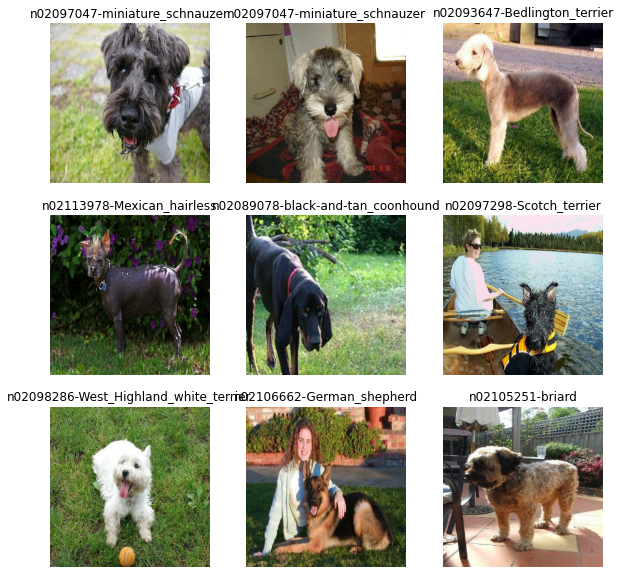

In [79]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")


In [80]:
normalization_layer = tf.keras.layers.Rescaling(1./255)

normalized_ds = ds.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next(iter(normalized_ds))
first_image = image_batch[0]
# Notice the pixel values are now in `[0,1]`.
print(np.min(first_image), np.max(first_image))


Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089
0.033205044 1.0


In [81]:
from PIL import Image

img = Image.new('RGB', (100, 100), 'red')
a = 1
b = 0
c = -50 #left/right (i.e. 5/-5)
d = 0
e = 1
f = 0 #up/down (i.e. 5/-5)
img = img.transform(img.size, Image.AFFINE, (a, b, c, d, e, f))
img.show()

<ipython-input-81-58f27bcc74c9>:10: DeprecationWarning: AFFINE is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transform.AFFINE instead.
  img = img.transform(img.size, Image.AFFINE, (a, b, c, d, e, f))
